# Predição de Preços de Casas no Condado de King

Este notebook tem como objetivo prever os preços de casas com base no dataset do Condado de King. Serão abordadas as etapas de carregamento dos dados, análise exploratória, pré-processamento e criação de modelos de machine learning.

# Setup

## Instalação e Importação de Bibliotecas

In [9]:
# Instalação das bibliotecas necessárias (caso ainda não estejam instaladas)
%pip install seaborn matplotlib scikit-learn xgboost lightgbm

  Using cached lightgbm-4.6.0-py3-none-win_amd64.whl.metadata (17 kB)
   ---------------------------------------- 0.0/150.0 MB ? eta -:--:--
   --- ------------------------------------ 14.7/150.0 MB 86.5 MB/s eta 0:00:02
   ---------- ---------------------------- 39.3/150.0 MB 103.3 MB/s eta 0:00:02
   ---------------- ---------------------- 62.1/150.0 MB 106.6 MB/s eta 0:00:01
   --------------------- ----------------- 82.6/150.0 MB 104.2 MB/s eta 0:00:01
   ------------------------- ------------ 101.7/150.0 MB 101.2 MB/s eta 0:00:01
   ------------------------------- ------ 122.9/150.0 MB 100.6 MB/s eta 0:00:01
   ------------------------------------ - 143.7/150.0 MB 100.2 MB/s eta 0:00:01
   --------------------------------------  149.9/150.0 MB 99.3 MB/s eta 0:00:01
   --------------------------------------  149.9/150.0 MB 99.3 MB/s eta 0:00:01
   --------------------------------------  149.9/150.0 MB 99.3 MB/s eta 0:00:01
   --------------------------------------  149.9/150.0 MB 9

In [3]:
# Importação das bibliotecas
# Bibliotecas essenciais para análise de dados e visualização
import numpy as np
import pandas as pd
import os
import seaborn as sns
from matplotlib import pyplot as plt

## Carregamento dos Dados

In [4]:
### Configuração de Estilo
# Definindo o estilo visual dos gráficos
plt.style.use('ggplot')

### Carregamento do Dataset
# Baixando e carregando o dataset de preços de casas do google drive
file_id = "1IpkwDDvtR4TiIGwcS1bJ_p4Ql8z9313b"
file_path = f"https://drive.google.com/uc?id={file_id}"

# Criando o DataFrame principal
csv_file = pd.read_csv(file_path, sep=',')
original_df = pd.DataFrame(csv_file)
original_df['date'] = pd.to_datetime(original_df.date)

# Análise Exploratória dos Dados (EDA)

In [ ]:
duplicated = original_df.duplicated(keep=False)
print(f"O DataFrame contém {duplicated.sum()} linha(s) duplicada(s).")
print("-----------------------------------------")
info = pd.DataFrame({
    'Coluna': original_df.columns,
    'Tipo': original_df.dtypes.values,
    'Não Nulos': original_df.notna().sum().values,
    'Total': len(original_df),
    '% Preenchido': (original_df.notna().sum() / len(original_df) * 100).round(2).values
})

print(info.to_string(index=False))

O DataFrame contém 0 linha(s) duplicada(s).
-----------------------------------------
       Coluna           Tipo  Não Nulos  Total  % Preenchido
           id          int64      21613  21613         100.0
         date datetime64[ns]      21613  21613         100.0
        price        float64      21613  21613         100.0
     bedrooms          int64      21613  21613         100.0
    bathrooms        float64      21613  21613         100.0
  sqft_living          int64      21613  21613         100.0
     sqft_lot          int64      21613  21613         100.0
       floors        float64      21613  21613         100.0
   waterfront          int64      21613  21613         100.0
         view          int64      21613  21613         100.0
    condition          int64      21613  21613         100.0
        grade          int64      21613  21613         100.0
   sqft_above          int64      21613  21613         100.0
sqft_basement          int64      21613  21613         100.0

In [ ]:
## Funções de Análise e Visualização
# Esta seção contém funções utilitárias para explorar os dados

### Funções para Exibição de Informações
def show_column_values(df, column, max_rows=50):
    """Mostra a distribuição de valores para uma coluna específica"""
    print(f"Distribuição de {column}")
    value_counts = df[column].value_counts()
    if len(value_counts) > max_rows:
        top_counts = value_counts.iloc[:max_rows]
        other_count = value_counts.iloc[max_rows:].sum()
        # Adiciona linha "Outros"
        top_counts['Outros'] = other_count
        value_counts = top_counts

    print(value_counts.to_frame().reset_index().to_string(index=False, header=[column, 'Count']))

def show_column_describe(df, column):
    """Exibe estatísticas descritivas de uma coluna do Dataframe"""
    stats = df[column].describe()
    print(stats.to_frame().to_string(header=False, float_format="%.2f"))

### Funções de Visualização
def show_histplot(df, column):
    """Gera um histograma para uma coluna"""
    plt.figure(figsize=(10, 6))
    sns.histplot(df[column], bins=50)
    plt.title(f"Distribuição de {column}")
    plt.xlabel(column)
    plt.ylabel("Contagem")
    plt.show()

def show_boxplot(df, column):
    """Gera um boxplot para uma coluna"""
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=df[column])
    plt.title(f"Boxplot de {column}")
    plt.xlabel(column)
    plt.show()

def show_scatterplot(df, column):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=column, y="price", data=df)
    plt.title(f"price vs {column}")
    plt.xlabel(column)
    plt.ylabel("price")
    plt.show()

def plot_heatmap(df, title, ignore_col):
    correlations = df[df.iloc[:,ignore_col:].columns].corr(method='kendall')
    fig, ax = plt.subplots(figsize=(30,30))
    ax = sns.heatmap(correlations, annot=True, cmap='coolwarm', linewidths=.5)
    ax.set_yticklabels(rotation=0, labels=correlations.columns)
    ax.set_xticklabels(rotation=0, labels=correlations.columns)
    ax.set_title(title)
    plt.show()

### Funções para Execução de Análises
def run_column_info(df, col, show_scatterplot_func  = True):
    """Executa uma função de análise em todas as colunas numéricas"""
    show_column_values(df, col)
    show_column_describe(df, col)
    show_boxplot(df, col)
    show_histplot(df, col)
    if(show_scatterplot_func  == True):
      show_scatterplot(df, col)

In [ ]:
## Análise Exploratória dos Dados
# Esta seção explora as características do dataset

### Estatísticas Descritivas
# Mostrando estatísticas básicas para todas as colunas numéricas
numeric_describe = original_df.iloc[:,2:].describe().apply(lambda s: s.apply('{:,.0f}'.format))
display(numeric_describe)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,"21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613","21,613"
mean,"540,088",3,2,"2,080","15,107",1,0,0,3,8,"1,788",292,"1,971",84,"98,078",48,-122,"1,987","12,768"
std,"367,127",1,1,918,"41,421",1,0,1,1,1,828,443,29,402,54,0,0,685,"27,304"
min,"75,000",0,0,290,520,1,0,0,1,1,290,0,"1,900",0,"98,001",47,-123,399,651
25%,"321,950",3,2,"1,427","5,040",1,0,0,3,7,"1,190",0,"1,951",0,"98,033",47,-122,"1,490","5,100"
50%,"450,000",3,2,"1,910","7,618",2,0,0,3,7,"1,560",0,"1,975",0,"98,065",48,-122,"1,840","7,620"
75%,"645,000",4,2,"2,550","10,688",2,0,0,4,8,"2,210",560,"1,997",0,"98,118",48,-122,"2,360","10,083"
max,"7,700,000",33,8,"13,540","1,651,359",4,1,4,5,13,"9,410","4,820","2,015","2,015","98,199",48,-121,"6,210","871,200"


### Bedrooms

A variável é um dado quantitativo discreto que indica a quantidade de quartos em cada imóvel do dataset. Essa característica é um dos fatores relevantes na avaliação de propriedades residenciais, pois está diretamente ligada à capacidade de acomodação e ao perfil de compradores.

Distribuição de bedrooms
bedrooms Count
       3  9824
       4  6882
       2  2760
       5  1601
       6   272
       1   199
       7    38
       0    13
       8    13
       9     6
      10     3
      11     1
      33     1
count 21613.00
mean      3.37
std       0.93
min       0.00
25%       3.00
50%       3.00
75%       4.00
max      33.00


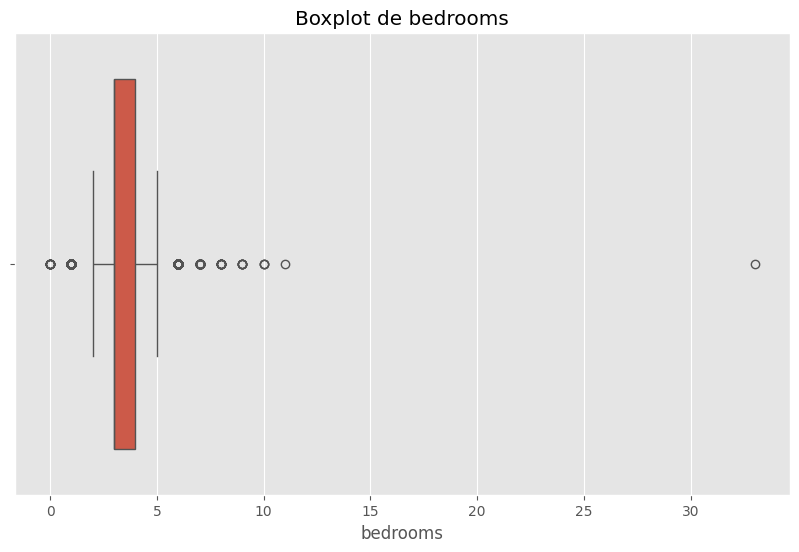

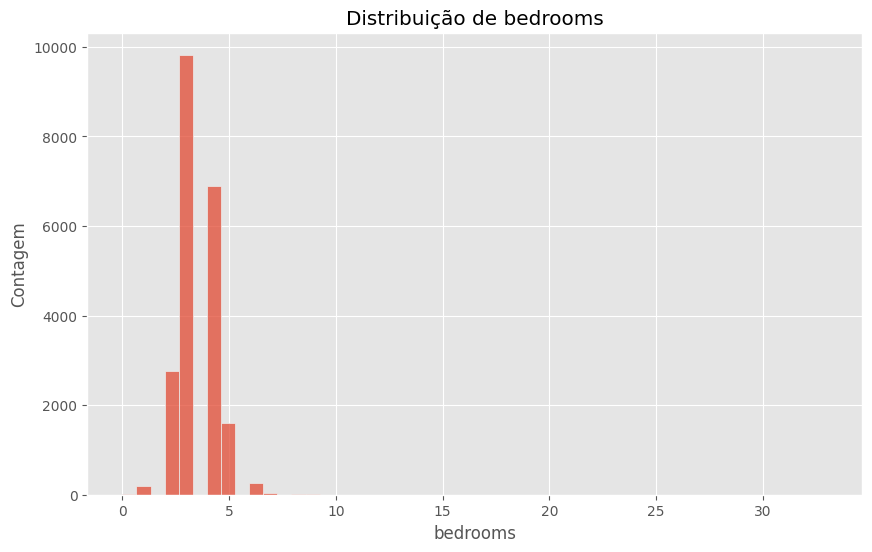

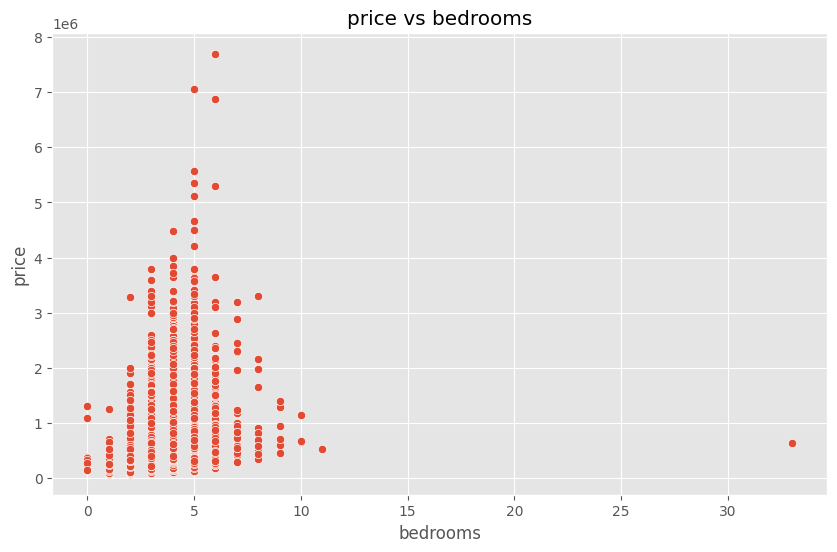

In [ ]:
### Visualização de Distribuições
run_column_info(original_df, 'bedrooms')

### Bathrooms

A variável de banheiros é quantitativa discreta (float64) com incrementos de 0.25, representando banheiros completos e combinações (como 1.75 = 1 banheiro completo + 3/4 banheiro).

Distribuição de bathrooms
bathrooms Count
     2.50  5380
     1.00  3852
     1.75  3048
     2.25  2047
     2.00  1930
     1.50  1446
     2.75  1185
     3.00   753
     3.50   731
     3.25   589
     3.75   155
     4.00   136
     4.50   100
     4.25    79
     0.75    72
     4.75    23
     5.00    21
     5.25    13
     0.00    10
     5.50    10
     1.25     9
     6.00     6
     0.50     4
     5.75     4
     6.75     2
     8.00     2
     6.50     2
     6.25     2
     7.75     1
     7.50     1
count 21613.00
mean      2.11
std       0.77
min       0.00
25%       1.75
50%       2.25
75%       2.50
max       8.00


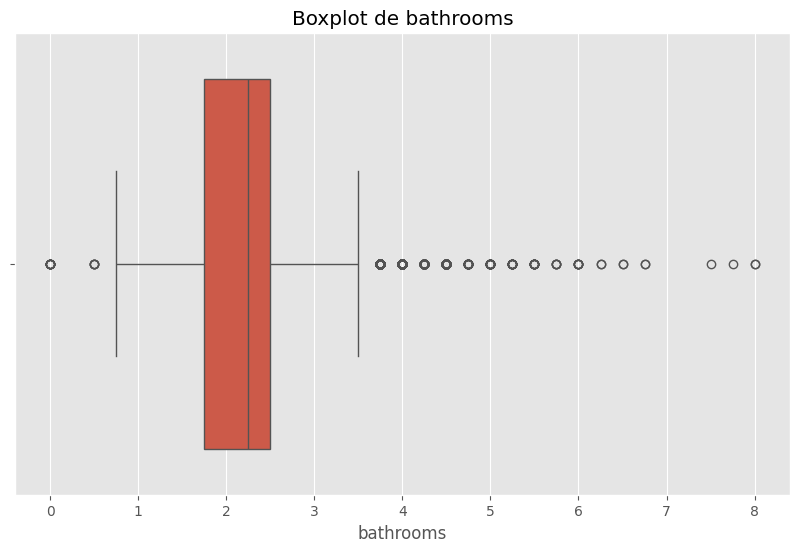

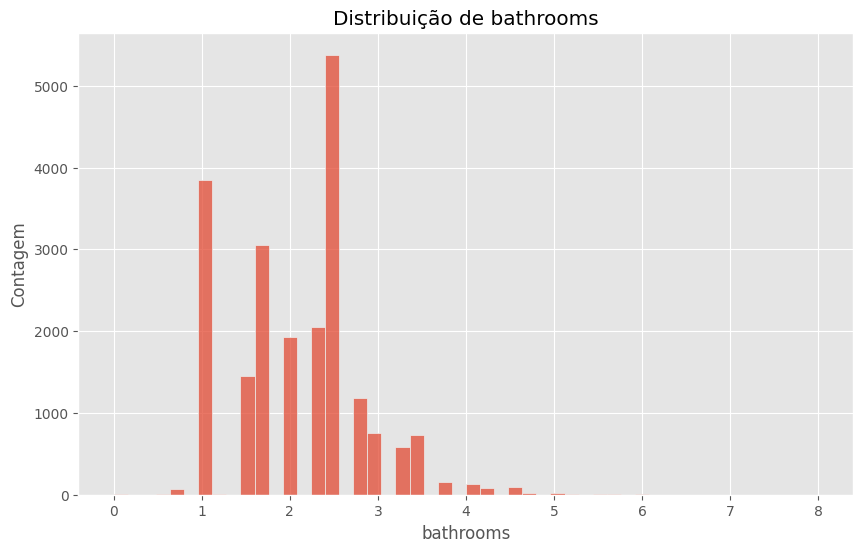

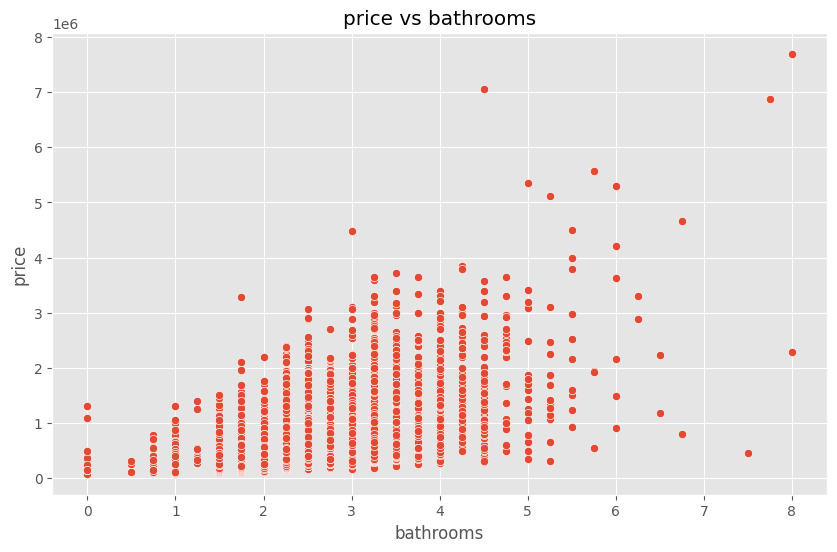

In [ ]:
### Visualização de Distribuições
run_column_info(original_df, 'bathrooms')

### Floors

A variável quantitativa contínua, medida em incrementos de 0,5, representa o número de andares em imóveis, sendo 1,0 para casas térreas, 1,5 para casas com mezanino ou sobrado parcial, 2,0 para sobrados completos e valores iguais ou superiores a 2,5 para mansões ou imóveis de luxo.

Distribuição de floors
floors Count
   1.0 10680
   2.0  8241
   1.5  1910
   3.0   613
   2.5   161
   3.5     8
count 21613.00
mean      1.49
std       0.54
min       1.00
25%       1.00
50%       1.50
75%       2.00
max       3.50


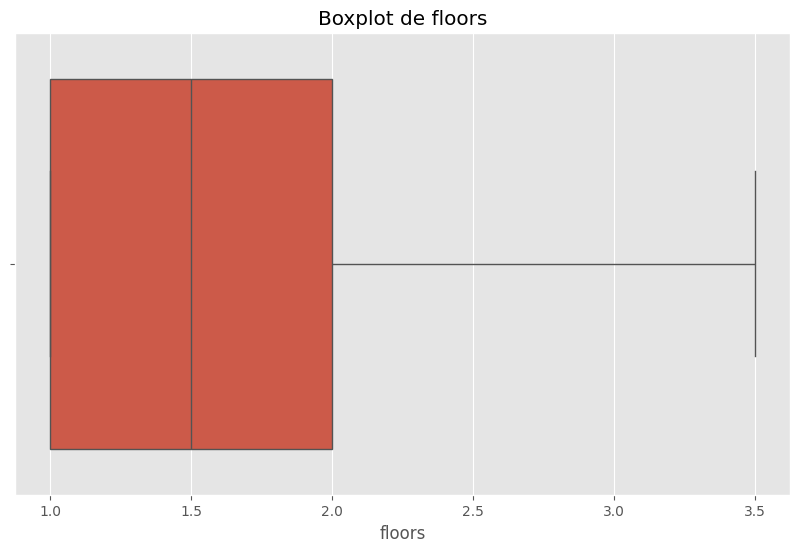

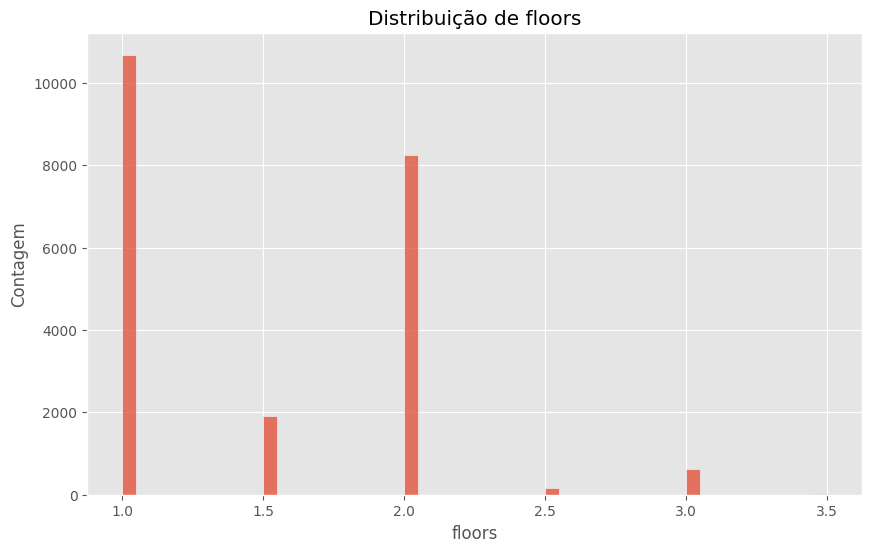

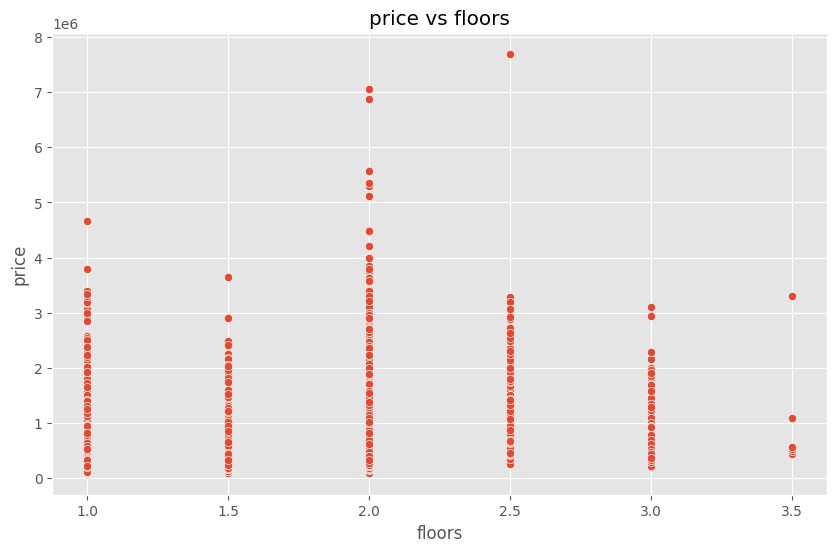

In [ ]:
### Visualização de Distribuições
run_column_info(original_df, 'floors')

### Sqft_living

A variável representa a área habitável em pés quadrados dos imóveis, revela um mercado imobiliário com distribuição assimétrica. Com uma média de 2,080 sqft e mediana de 1,910 sqft, observa-se que a maioria das propriedades concentra-se em tamanhos moderados, típicos de residências familiares, enquanto alguns poucos imóveis de luxo distorcem a distribuição para cima.

Distribuição de sqft_living
sqft_living Count
       1300   138
       1400   135
       1440   133
       1660   129
       1800   129
       1010   129
       1820   128
       1480   125
       1720   125
       1540   124
       1560   124
       1320   122
       1250   120
       1580   119
       1200   118
       1370   118
       1650   117
       1780   117
       1900   117
       1430   116
       1460   116
       2100   116
       1680   116
       1740   115
       1830   114
       1510   114
       1340   113
       1260   113
       1610   112
       1640   112
       1240   112
       1500   112
       1470   112
       2120   111
       1690   110
       1790   110
       1960   110
       1530   109
       1600   109
       1410   109
       1670   109
       1700   108
       1980   105
       1760   104
       1590   104
       2020   104
       2040   104
       2000   103
       1270   102
       1520   102
     Outros 15840
count 21613.00
mean   2079.90
std   

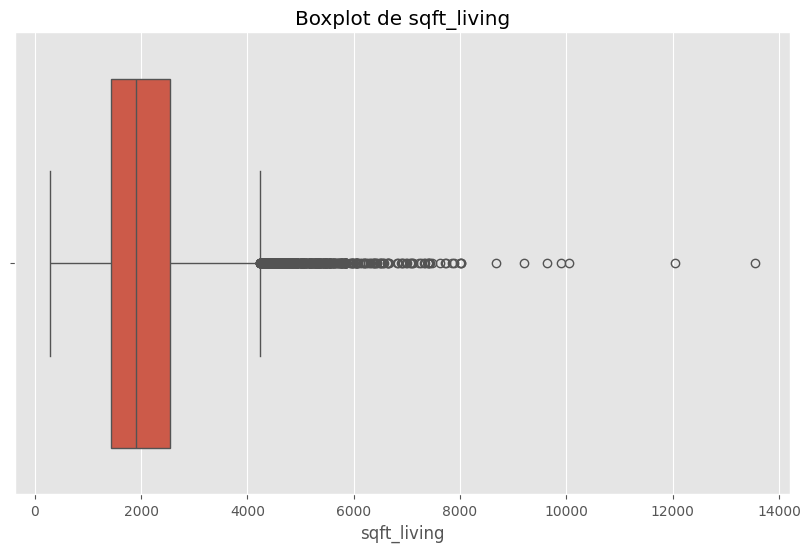

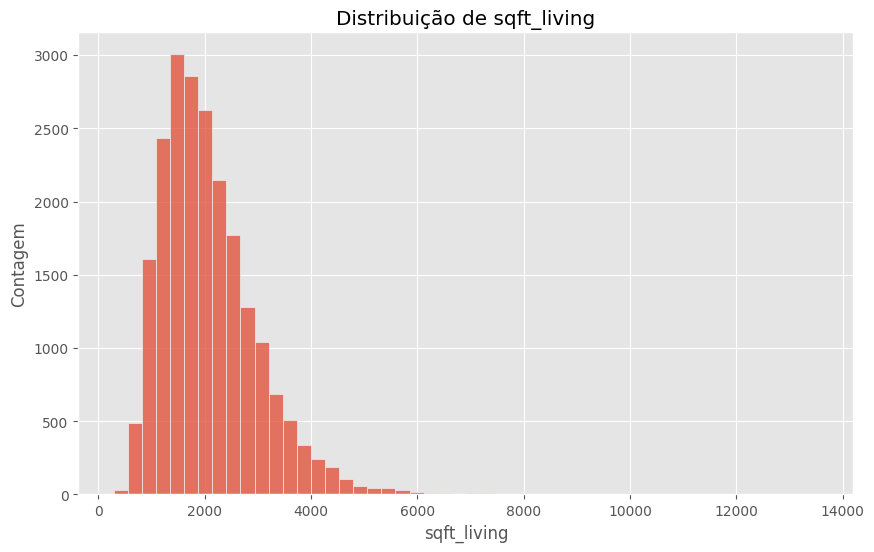

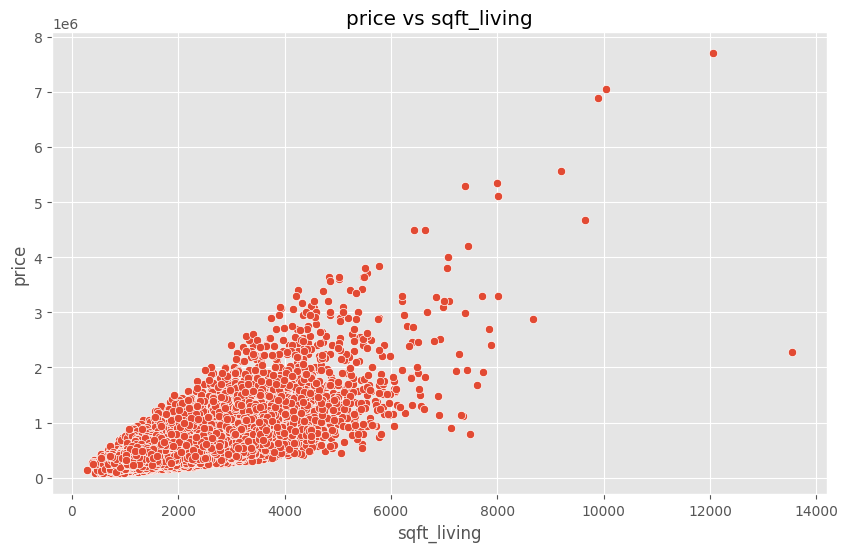

In [ ]:
run_column_info(original_df, 'sqft_living')

### Sqft_lot

A variável sqft_lot, que representa a área total do terreno em pés quadrados, mostra uma distribuição extremamente assimétrica, com a maioria dos imóveis concentrados em lotes modestos, enquanto alguns poucos terrenos gigantescos distorcem completamente a média.

Distribuição de sqft_lot
sqft_lot Count
    5000   358
    6000   290
    4000   251
    7200   220
    4800   120
    7500   119
    4500   114
    8400   111
    9600   109
    3600   103
    9000    93
    3000    84
    5100    78
    8000    76
    7000    76
    5500    73
    8100    72
    7800    69
    4080    67
    7700    66
    7350    64
    5200    64
    5750    61
    4400    56
    5400    54
    6600    52
    6250    50
    4200    49
    7560    48
   10000    46
   10800    44
    9750    43
   12000    42
    8800    42
    6500    40
    6120    39
    7210    38
    2500    36
    4600    34
    8250    34
    5250    32
    6300    32
    3200    31
   10500    31
    6380    31
    7620    30
    5700    30
   10200    30
    9900    29
    5040    29
  Outros 17823
count   21613.00
mean    15106.97
std     41420.51
min       520.00
25%      5040.00
50%      7618.00
75%     10688.00
max   1651359.00


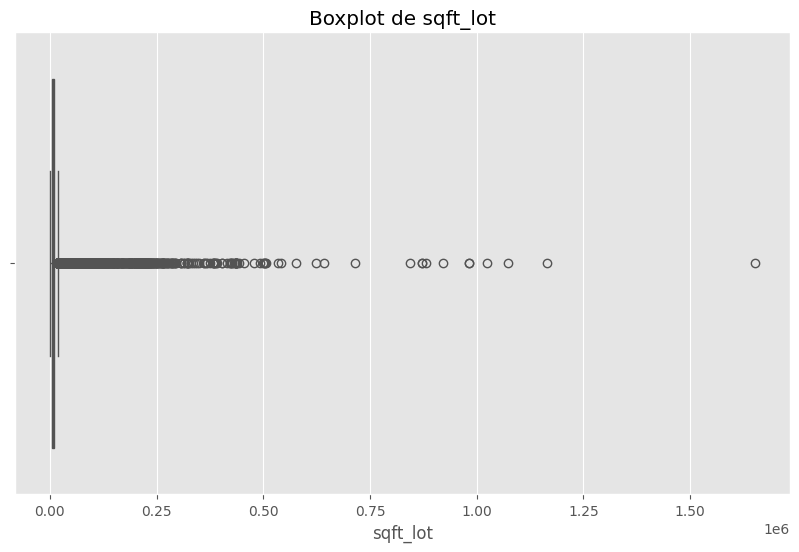

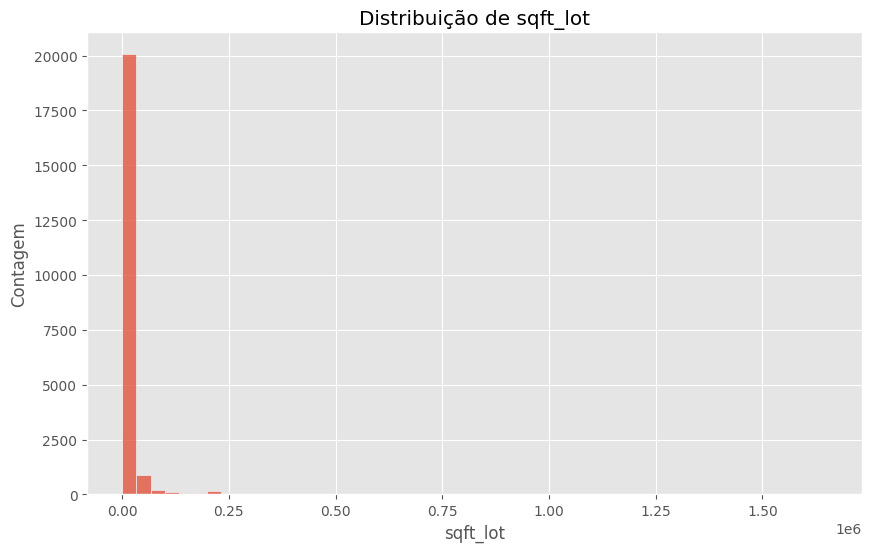

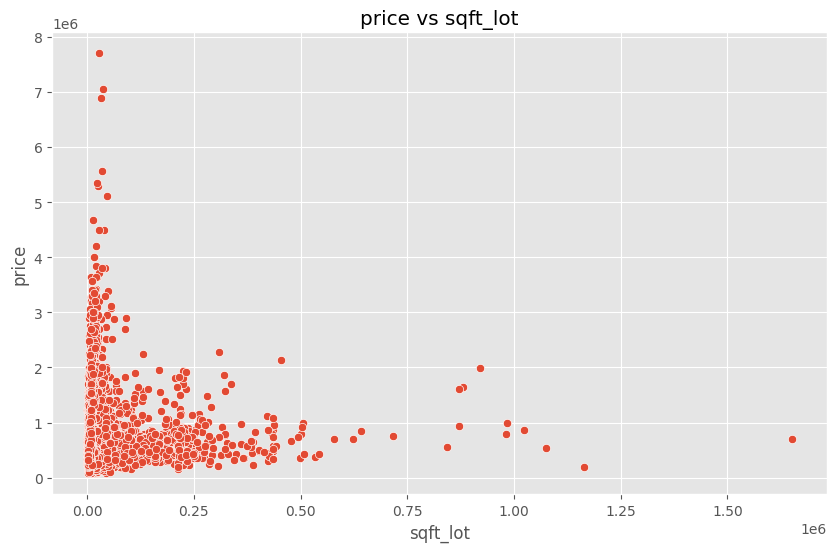

In [ ]:
run_column_info(original_df, 'sqft_lot')

###  Grade (Qualidade de Construção)

A variável classifica a qualidade construtiva dos imóveis em uma escala de 1 a 13, onde cada nível reflete materiais, acabamentos e padrões arquitetônicos específicos.

- **Graus 1-3 (Inferiores):** Construções que não atendem aos padrões mínimos, como cabanas ou estruturas precárias, com materiais de baixa qualidade.
- **Grau 4 (Antigas/Deficientes):** Imóveis mais velhos, abaixo dos códigos atuais, com técnicas ultrapassadas.
- **Grau 5 (Econômicas):** Atende apenas o mínimo legal, com projetos funcionais e materiais básicos (drywall, pisos laminados).
- **Grau 6 (Aceitável):** Cumpre o código vigente, mas com designs simples e materiais moderados.
- **Grau 7 (Médio/Mercado):** Representa a maioria dos subúrbios, com acabamentos comuns (azulejos padrão, armários de madeira compensada).
- **Grau 8 (Acima da Média):** Materiais superiores (pisos de madeira maciça, bancadas em granito) e projetos mais elaborados.
- **Grau 9 (Superior):** Detalhes refinados, espaços amplos e funcionais.
- **Grau 10 (Alto Padrão):** Materiais premium (porcelanato, iluminação embutida) e plantas otimizadas.
- **Grau 11 (Luxo Personalizado):** Projetos sob medida com madeiras nobres, mármores e automação residencial.
- **Grau 12 (Excelência):** Construtora premium, materiais importados e tecnologias de ponta.
- **Grau 13 (Mansão):** Propriedades exclusivas, com arquitetura de luxo e áreas de lazer sofisticadas.

Distribuição de grade
grade Count
    7  8981
    8  6068
    9  2615
    6  2038
   10  1134
   11   399
    5   242
   12    90
    4    29
   13    13
    3     3
    1     1
count 21613.00
mean      7.66
std       1.18
min       1.00
25%       7.00
50%       7.00
75%       8.00
max      13.00


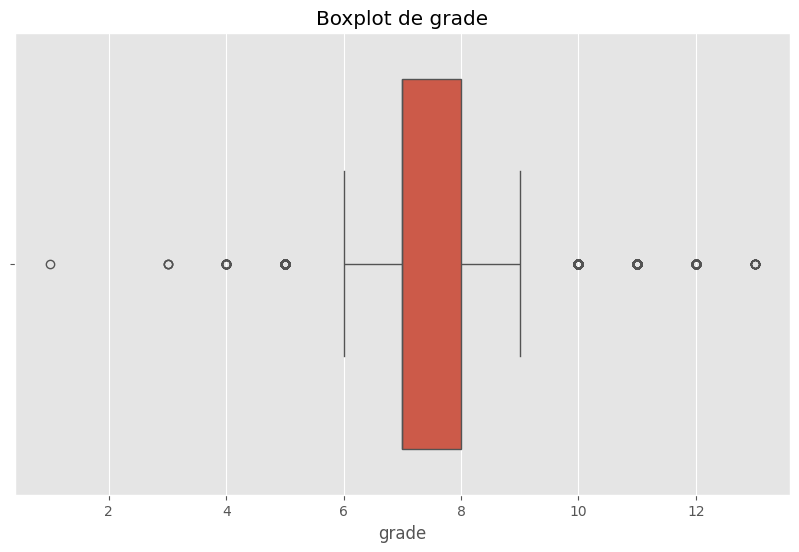

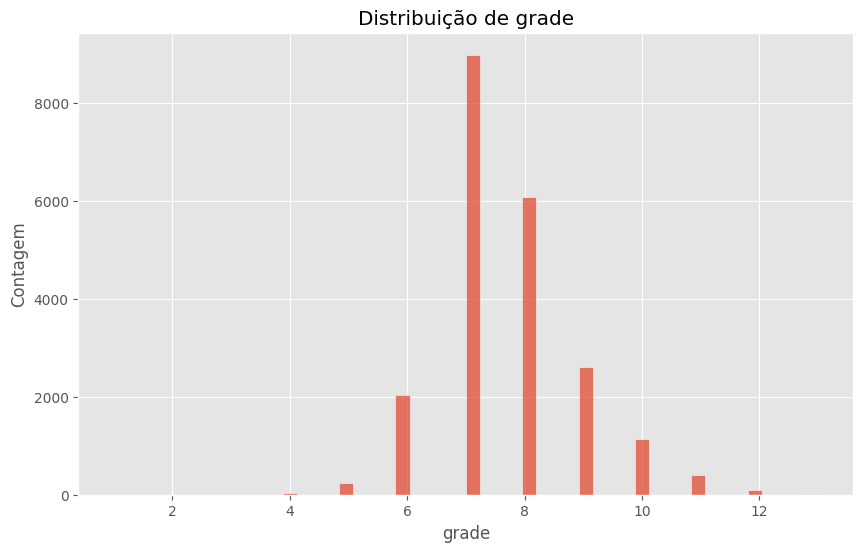

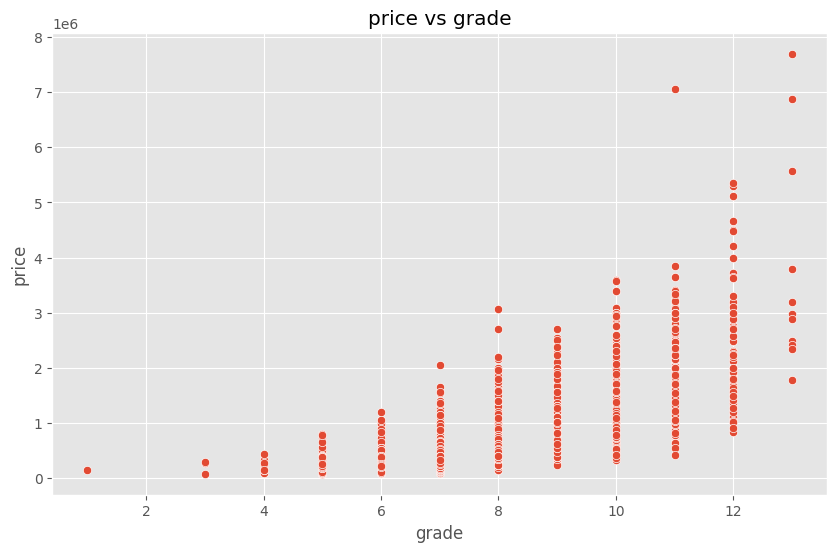

In [ ]:
run_column_info(original_df, 'grade')

###  Condition (Estado de Conservação)

Avalia o estado do imóvel em relação à sua idade e qualidade, variando de 1 (Péssimo) a 5 (Excelente):

- **1 (Péssimo):** Requer grandes reformas (telhado, encanamento, etc.), com desgaste extremo.
- **2 (Regular):** Necessidade de várias reparações, mas ainda funcional.
- **3 (Médio):** Pequenos reparos necessários, mas em condições aceitáveis para a idade.
- **4 (Bom):** Bem conservado, com utilidade acima da média para sua categoria.
- **5 (Excelente):** Imóvel muito bem cuidado, com manutenção frequente e poucos sinais de desgaste.

Distribuição de condition
condition Count
        3 14031
        4  5679
        5  1701
        2   172
        1    30
count 21613.00
mean      3.41
std       0.65
min       1.00
25%       3.00
50%       3.00
75%       4.00
max       5.00


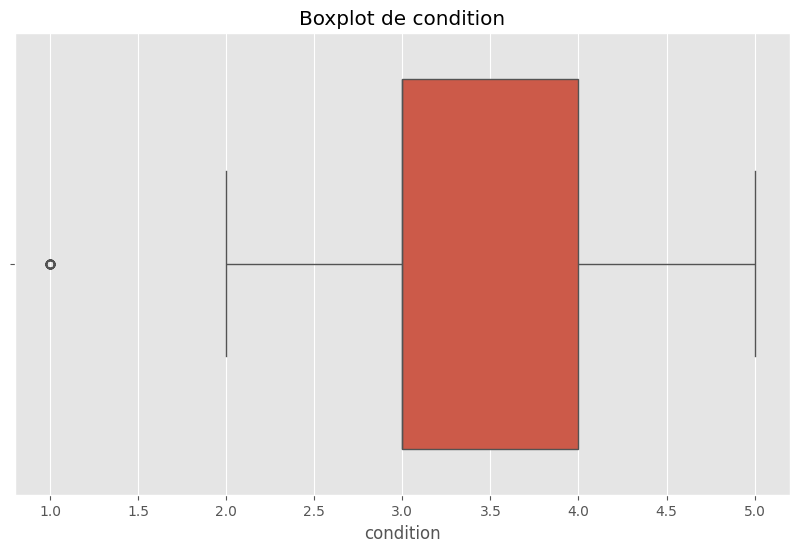

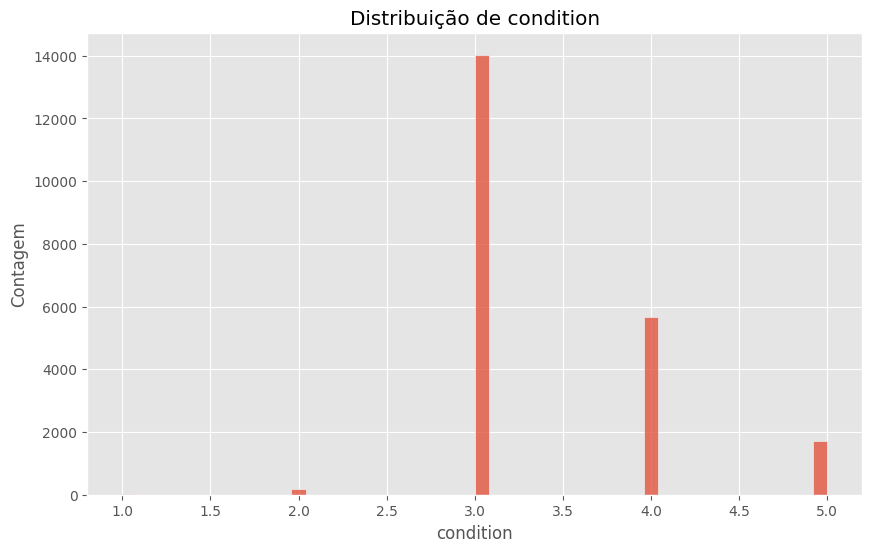

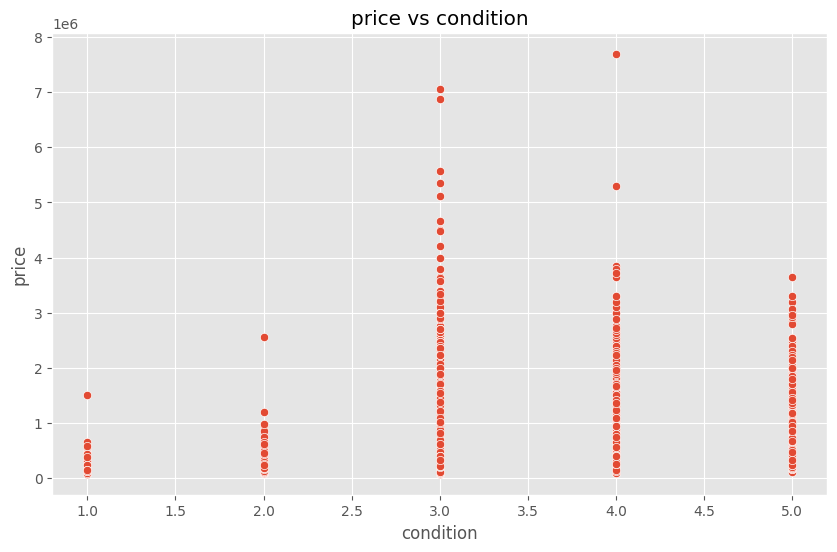

In [ ]:
run_column_info(original_df, 'condition')

###  View (Vista do Imóvel)

Indica se a propriedade possui vista para paisagens específicas, como:

- Montanhas (Rainier, Olympics, Cascades)
- Corpos d’água (Puget Sound, Lake Washington, rios)
- Panorama urbano (Seattle Skyline)
- Outras vistas (Territorial, Other View)

Distribuição de view
view Count
   0 19489
   2   963
   3   510
   1   332
   4   319
count 21613.00
mean      0.23
std       0.77
min       0.00
25%       0.00
50%       0.00
75%       0.00
max       4.00


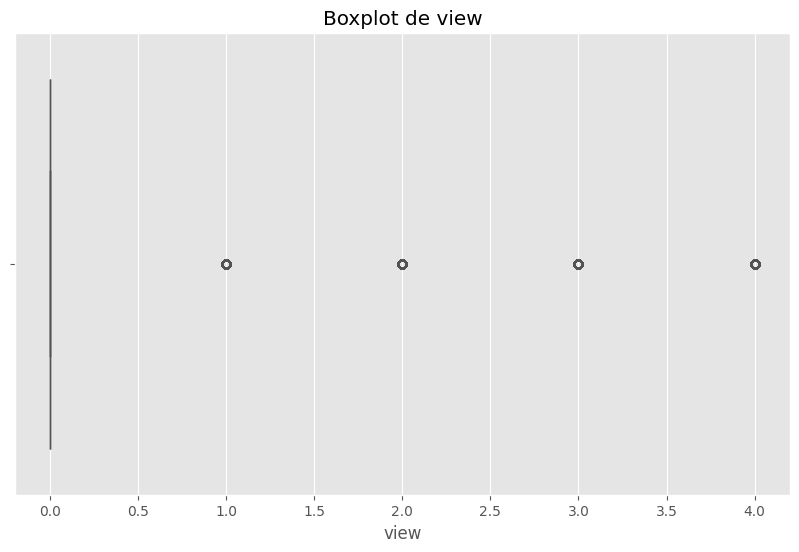

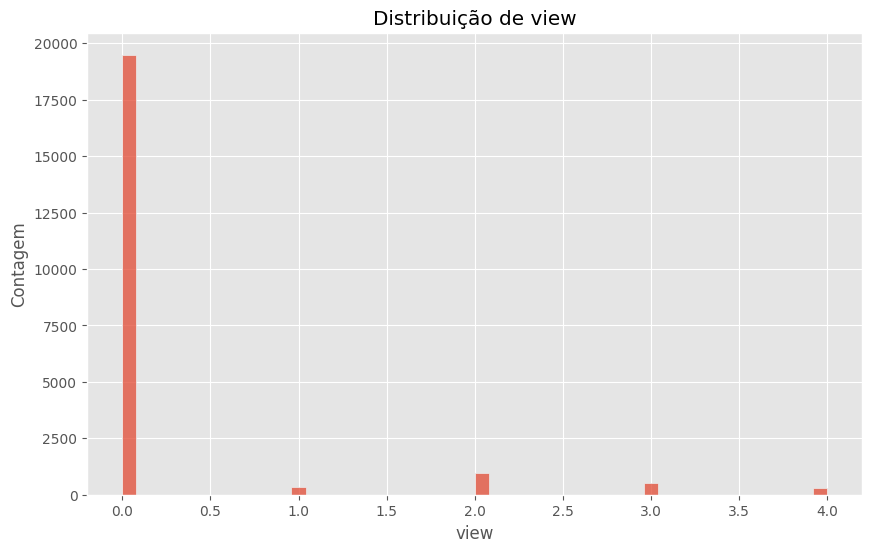

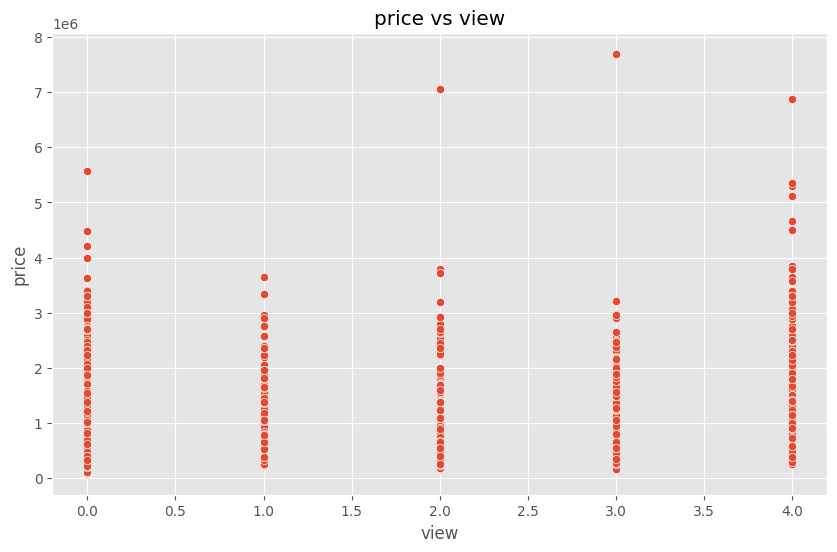

In [ ]:
run_column_info(original_df, 'view')

###  Waterfront (Proximidade à Água)

Identifica se o imóvel está próximo a áreas como:

- Margens de lagos, rios ou oceano (Waterfront Location)
- Terrenos com profundidade específica (Lot Depth Factor)
- Áreas com acesso direto à água (Waterfront Footage)


Distribuição de waterfront
waterfront Count
         0 21450
         1   163
count 21613.00
mean      0.01
std       0.09
min       0.00
25%       0.00
50%       0.00
75%       0.00
max       1.00


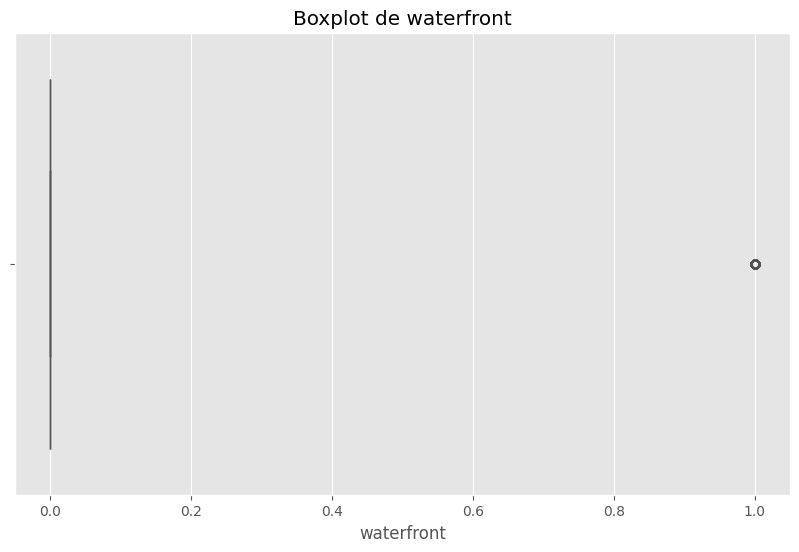

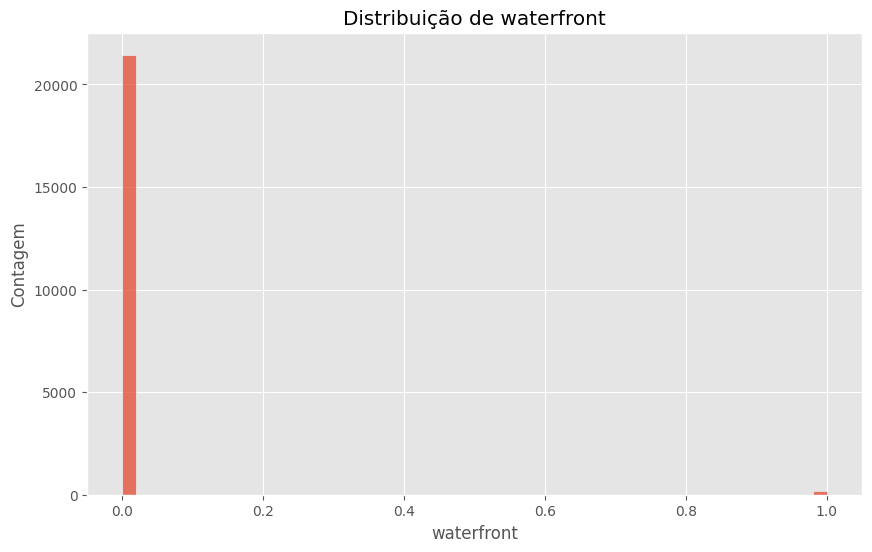

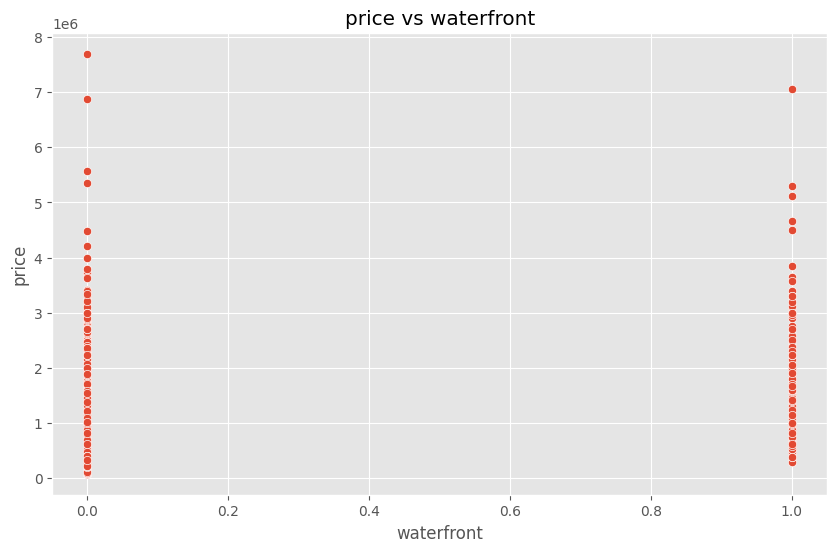

In [ ]:
run_column_info(original_df, 'waterfront')

### Zipcode

Distribuição de zipcode
zipcode Count
  98103   602
  98038   590
  98115   583
  98052   574
  98117   553
  98042   548
  98034   545
  98118   508
  98023   499
  98006   498
  98133   494
  98059   468
  98058   455
  98155   446
  98074   441
  98033   432
  98027   412
  98125   410
  98056   406
  98053   405
  98001   362
  98075   359
  98126   354
  98092   351
  98144   343
  98106   335
  98116   330
  98029   321
  98004   317
  98199   317
  98065   310
  98122   290
  98146   288
  98028   283
  98008   283
  98040   282
  98198   280
  98003   280
  98031   274
  98072   273
  98112   269
  98168   269
  98055   268
  98107   266
  98136   263
  98178   262
  98030   256
  98177   255
  98166   254
  98022   234
  98105   229
  98045   221
  98002   199
  98077   198
  98011   195
  98019   190
  98108   186
  98119   184
  98005   168
  98007   141
  98188   136
  98032   125
  98014   124
  98070   118
  98109   109
  98102   105
  98010   100
  98024    81
  98148   

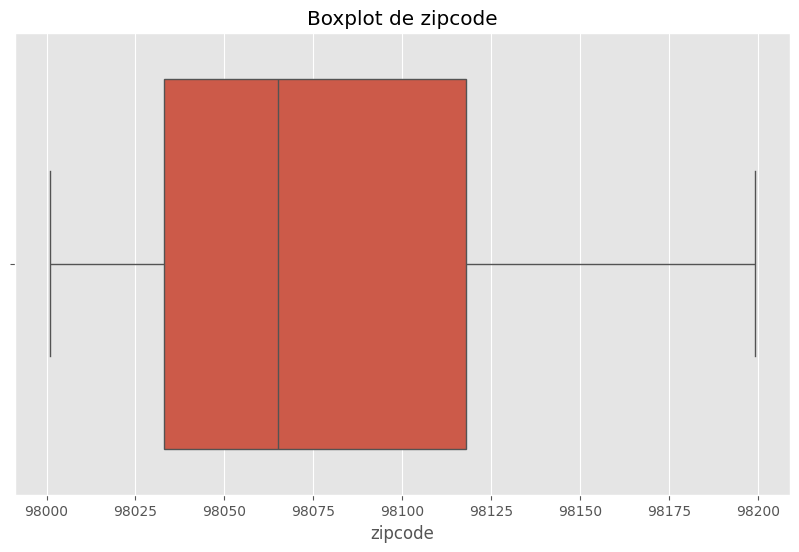

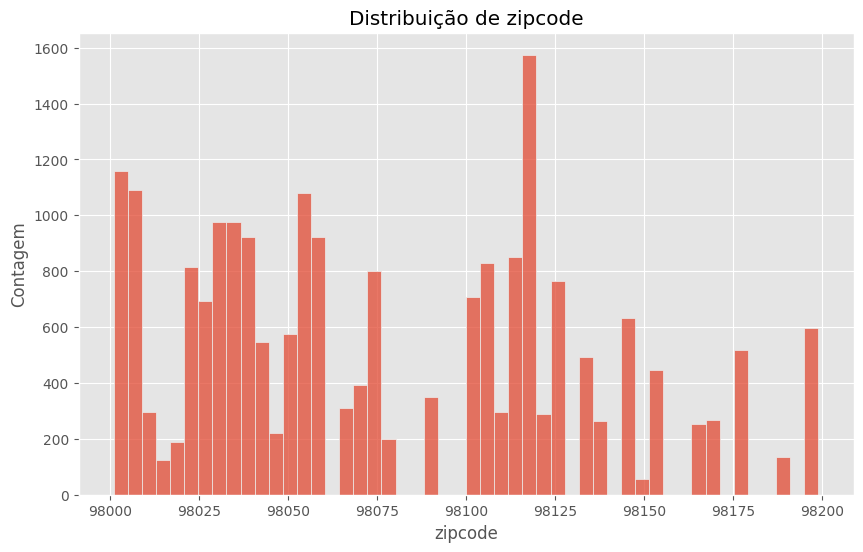

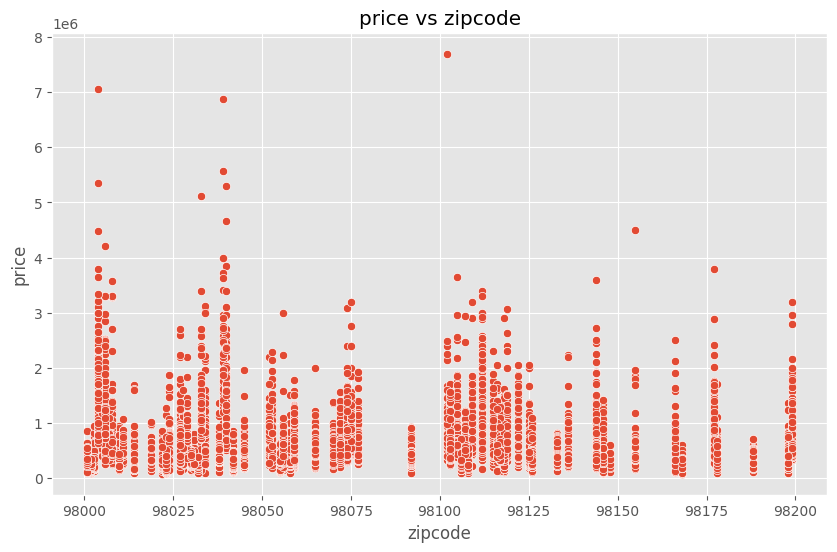

In [ ]:
### Visualização de Distribuições
run_column_info(original_df, 'zipcode')

### Latitude


Distribuição de lat
     lat Count
 47.6846    17
 47.6624    17
 47.5491    17
 47.5322    17
 47.6711    16
 47.6955    16
 47.6886    16
  47.686    15
 47.5402    15
 47.6647    15
 47.6904    15
 47.6842    15
 47.5396    14
 47.6651    14
 47.5533    14
 47.6914    14
 47.5342    14
 47.5445    14
 47.5518    14
 47.5323    14
 47.6853    14
 47.6534    14
 47.6821    14
 47.6374    14
 47.5427    14
   47.54    14
 47.7076    14
 47.6729    14
 47.6727    14
 47.6844    14
 47.6765    13
 47.6875    13
 47.5659    13
 47.6388    13
 47.5503    13
 47.6368    13
 47.6285    13
 47.6916    13
 47.7222    13
  47.697    13
 47.6968    13
 47.6801    13
 47.6754    13
 47.6857    13
 47.6981    13
 47.5305    13
 47.6971    13
 47.6684    13
 47.7289    12
 47.5707    12
  Outros 20912
count 21613.00
mean     47.56
std       0.14
min      47.16
25%      47.47
50%      47.57
75%      47.68
max      47.78


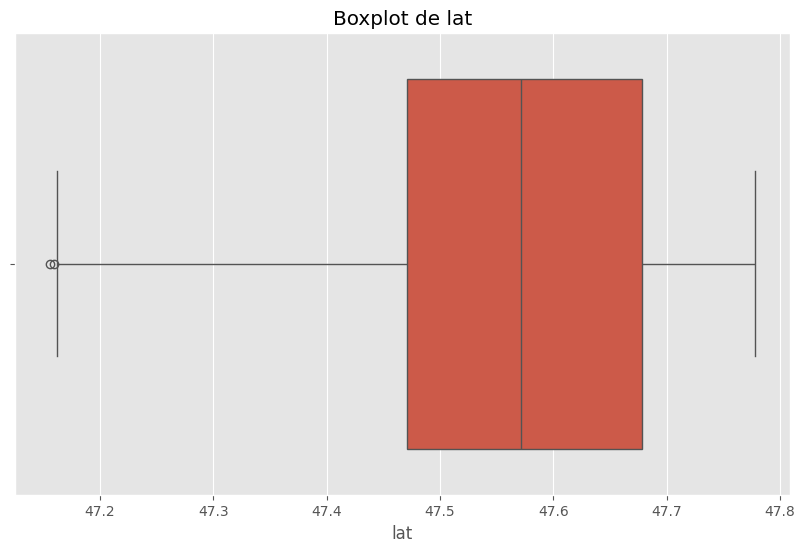

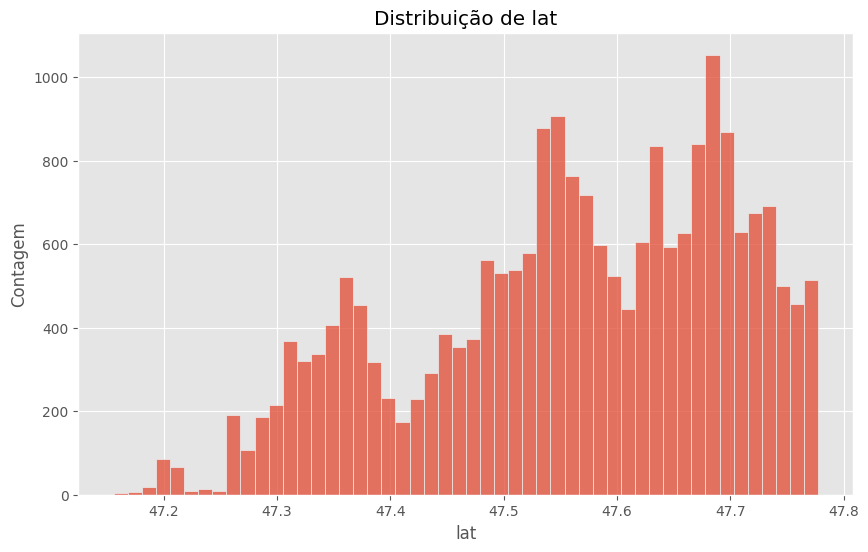

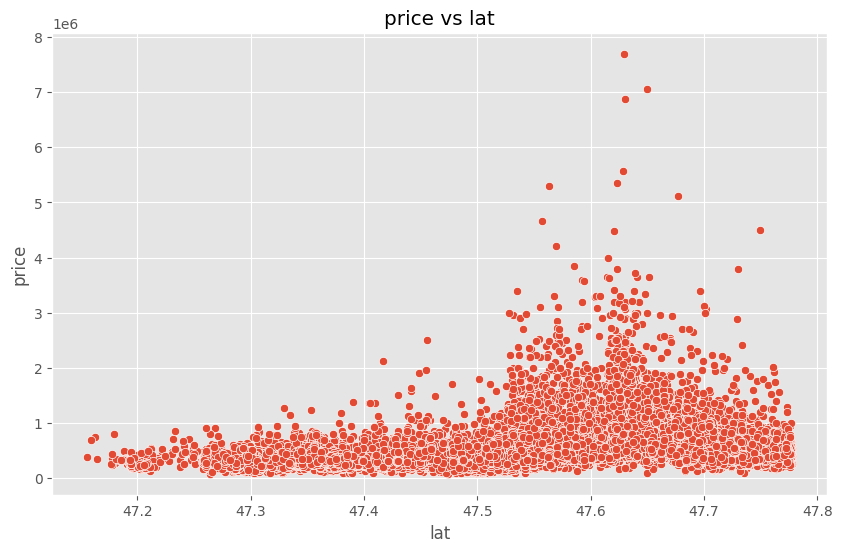

In [ ]:
run_column_info(original_df, 'lat')

### Longitude

Distribuição de long
    long Count
 -122.29   116
  -122.3   111
-122.362   104
-122.291   100
-122.372    99
-122.363    99
-122.288    98
-122.357    96
-122.284    95
-122.365    94
-122.172    94
-122.306    93
-122.346    93
-122.299    92
-122.375    92
-122.351    92
-122.348    92
-122.304    92
-122.295    91
 -122.35    90
-122.292    90
-122.285    90
-122.352    89
-122.289    89
-122.359    88
-122.298    88
-122.384    87
-122.301    86
-122.316    86
-122.317    86
-122.287    85
-122.391    85
-122.354    85
-122.353    85
-122.361    85
-122.385    84
-122.311    84
-122.189    83
-122.286    83
-122.371    83
 -122.37    81
-122.388    81
-122.378    81
-122.349    81
 -122.34    80
-122.387    79
-122.308    78
-122.358    78
-122.331    78
-122.307    78
  Outros 17164
count 21613.00
mean   -122.21
std       0.14
min    -122.52
25%    -122.33
50%    -122.23
75%    -122.12
max    -121.31


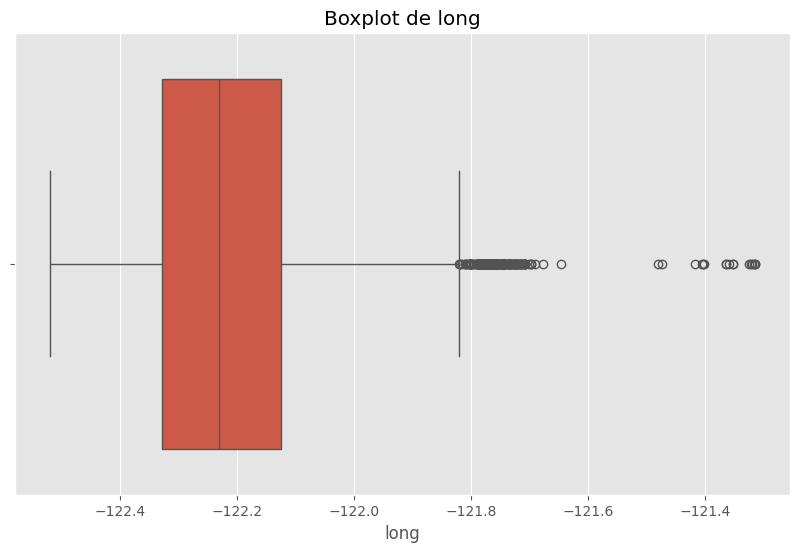

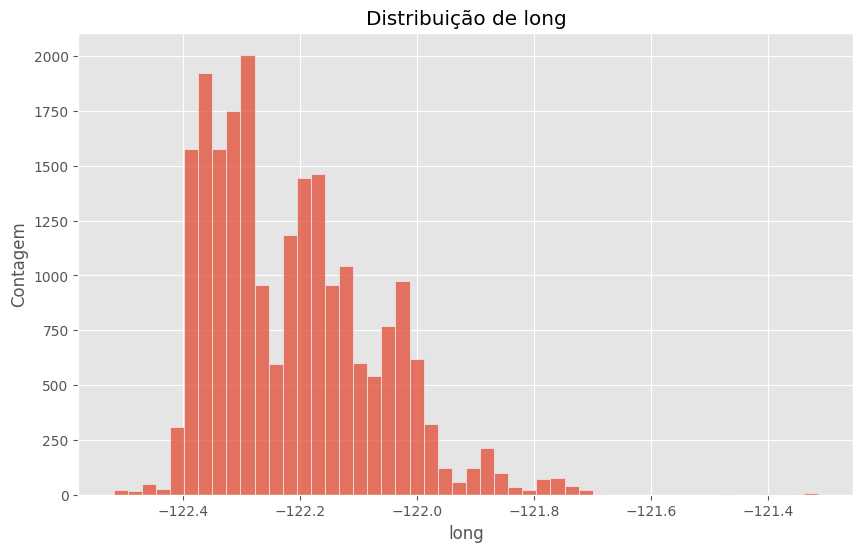

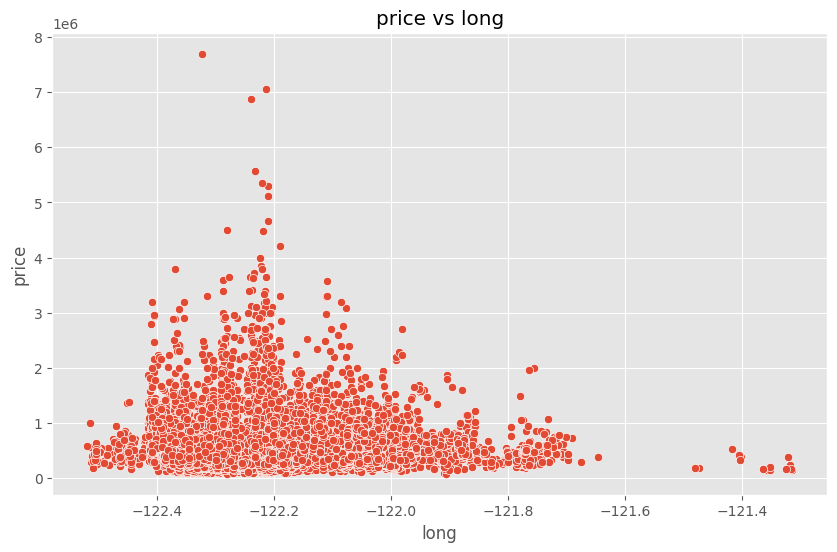

In [ ]:
run_column_info(original_df, 'long')

### Price

Distribuição de price
    price Count
 450000.0   172
 350000.0   172
 550000.0   159
 500000.0   152
 425000.0   150
 325000.0   148
 400000.0   145
 375000.0   138
 300000.0   133
 525000.0   131
 250000.0   130
 475000.0   120
 330000.0   119
 650000.0   117
 275000.0   113
 315000.0   111
 415000.0   111
 390000.0   110
 600000.0   110
 440000.0   109
 280000.0   109
 320000.0   107
 435000.0   105
 340000.0   103
 310000.0   101
 335000.0    98
 420000.0    97
 360000.0    96
 260000.0    95
 265000.0    94
 625000.0    93
 575000.0    93
 380000.0    92
 305000.0    92
 530000.0    91
 345000.0    91
 430000.0    91
 270000.0    90
 465000.0    89
 245000.0    89
 700000.0    89
 290000.0    88
 370000.0    88
 490000.0    88
 750000.0    87
 410000.0    86
 385000.0    86
 255000.0    86
 355000.0    86
 230000.0    85
   Outros 16131
count   21566.00
mean   540823.47
std    367013.68
min    102500.00
25%    323000.00
50%    450000.00
75%    645000.00
max   7700000.00


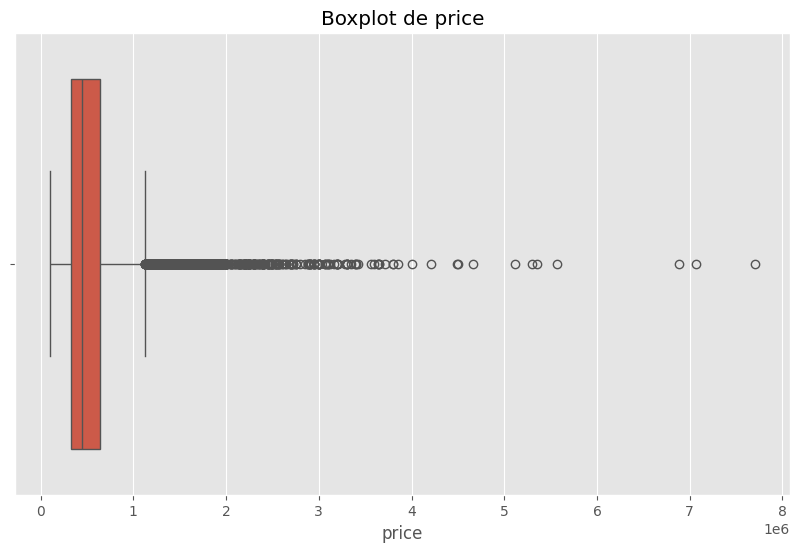

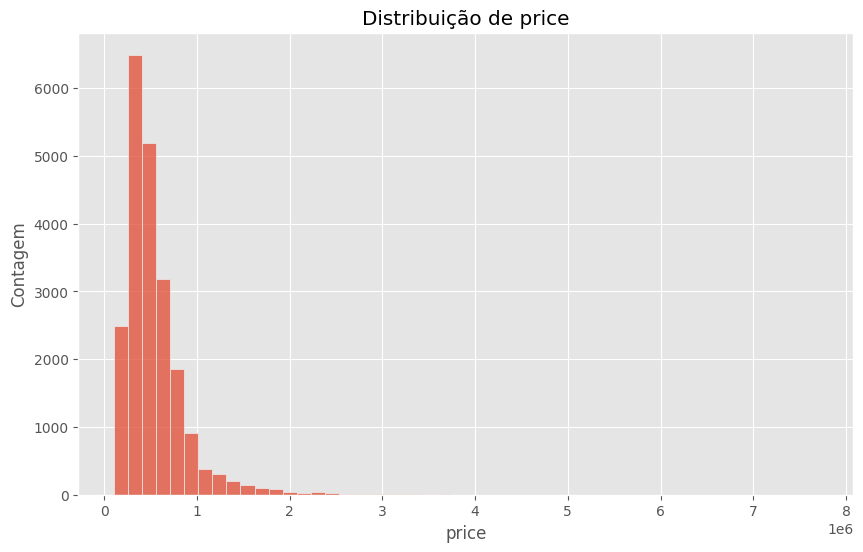

In [ ]:
run_column_info(original_df, 'price', False)

## HeatMap

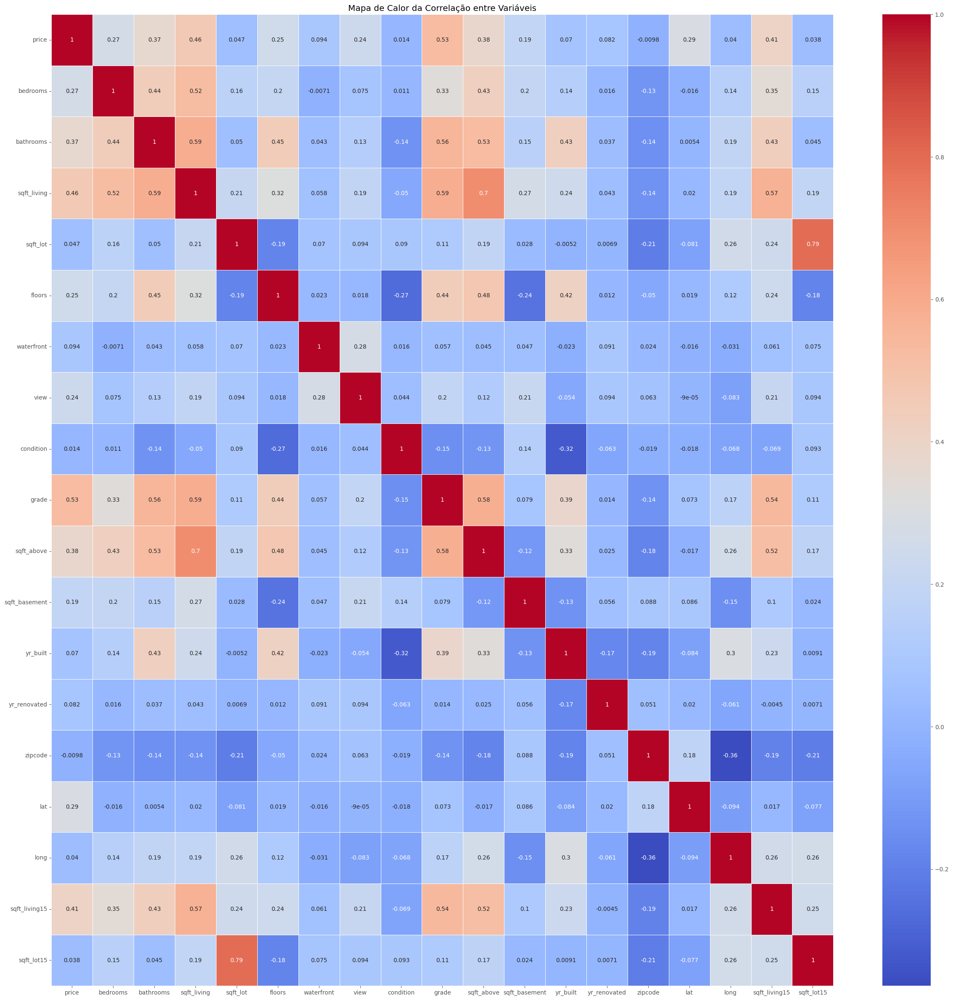

In [ ]:
# Visualização da correlação entre variáveis numéricas
plot_heatmap(original_df, 'Mapa de Calor da Correlação entre Variáveis', 2)

In [ ]:
# Análise de imóveis que foram vendidos mais de uma vez no período
ids = original_df["id"]
original_df[ids.isin(ids[ids.duplicated()])].sort_values("id")

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2496,1000102,2014-09-16,280000.0,6,3.00,2400,9373,2.0,0,0,...,7,2400,0,1991,0,98002,47.3262,-122.214,2060,7316
2497,1000102,2015-04-22,300000.0,6,3.00,2400,9373,2.0,0,0,...,7,2400,0,1991,0,98002,47.3262,-122.214,2060,7316
16814,7200179,2014-10-16,150000.0,2,1.00,840,12750,1.0,0,0,...,6,840,0,1925,0,98055,47.4840,-122.211,1480,6969
16815,7200179,2015-04-24,175000.0,2,1.00,840,12750,1.0,0,0,...,6,840,0,1925,0,98055,47.4840,-122.211,1480,6969
11433,109200390,2014-08-20,245000.0,3,1.75,1480,3900,1.0,0,0,...,7,1480,0,1980,0,98023,47.2977,-122.367,1830,6956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6345,9828200460,2014-06-27,260000.0,2,1.00,700,4800,1.0,0,0,...,7,700,0,1922,0,98122,47.6147,-122.300,1440,4800
15200,9834200305,2015-02-10,615000.0,3,1.00,1790,3876,1.5,0,0,...,7,1090,700,1904,0,98144,47.5750,-122.288,1360,4080
15199,9834200305,2014-07-16,350000.0,3,1.00,1790,3876,1.5,0,0,...,7,1090,700,1904,0,98144,47.5750,-122.288,1360,4080
1086,9834200885,2015-04-20,550000.0,4,2.50,2080,4080,1.0,0,0,...,7,1040,1040,1962,0,98144,47.5720,-122.290,1340,4080


In [ ]:
import folium

def create_interactive_map(df, lat_col, lon_col, popup_col=None):
    center_lat = df[lat_col].mean()
    center_lon = df[lon_col].mean()

    m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

    for idx, row in df.iterrows():
        popup = str(row[popup_col]) if popup_col else None
        folium.CircleMarker(
            location=[row[lat_col], row[lon_col]],
            radius=5,
            popup=popup,
            fill=True
        ).add_to(m)

    return m

create_interactive_map(original_df, "lat", "long", "price")


# Pré-processamento dos Dados

In [5]:
## Tratamento de Dados
# Esta seção lida com limpeza e preparação dos dados

### Correção de Erros no Dataset
# Removendo um outlier evidente no número de quartos
original_df = original_df.query('0 < bedrooms < 33 and 0 < bathrooms')

In [ ]:
### Funções para Tratamento de Outliers
def remove_outliers_iqr(df, columns, factor=2.5):
    df_clean = df.copy()
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - factor * IQR
        upper_bound = Q3 + factor * IQR
        df_clean = df_clean[(df_clean[col] >= lower_bound) & (df_clean[col] <= upper_bound)]
    return df_clean

def remove_outliers_zscore(df, columns, threshold=5):
    df_clean = df.copy()
    for col in columns:
        z_scores = np.abs((df[col] - df[col].mean()) / df[col].std())
        df_clean = df_clean[z_scores < threshold]
    return df_clean

from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor

def isolation_forest_outliers(df, contamination=0.1):
    clf = IsolationForest(contamination=contamination, random_state=42)
    preds = clf.fit_predict(df)
    return df[preds == 1]

def lof_outliers(df, n_neighbors=20, contamination=0.1):
    lof = LocalOutlierFactor(n_neighbors=n_neighbors, contamination=contamination)
    preds = lof.fit_predict(df)
    return df[preds == 1]

In [ ]:
### Aplicação dos Métodos de Tratamento
numeric_cols = original_df.select_dtypes(include=['number']).columns.tolist()
clean_data_iqr = remove_outliers_iqr(original_df, numeric_cols)
clean_data_z = remove_outliers_zscore(original_df, numeric_cols)
clean_data_iso = isolation_forest_outliers(original_df[numeric_cols])
clean_data_lof = lof_outliers(original_df[numeric_cols])

# Comparando os resultados dos diferentes métodos
print(f"Original shape: {original_df.shape}")
print(f"After IQR cleaning: {clean_data_iqr.shape}")
print(f"After Z-Score: {clean_data_z.shape}")
print(f"After Isolation Forest: {clean_data_iso.shape}")
print(f"After LOF: {clean_data_lof.shape}")

/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[z_scores < threshold]
/tmp/ipython-input-9-3561927455.py:17: UserWar

Original shape: (21596, 21)
After IQR cleaning: (16682, 21)
After Z-Score: (20978, 21)
After Isolation Forest: (19436, 20)
After LOF: (19436, 20)


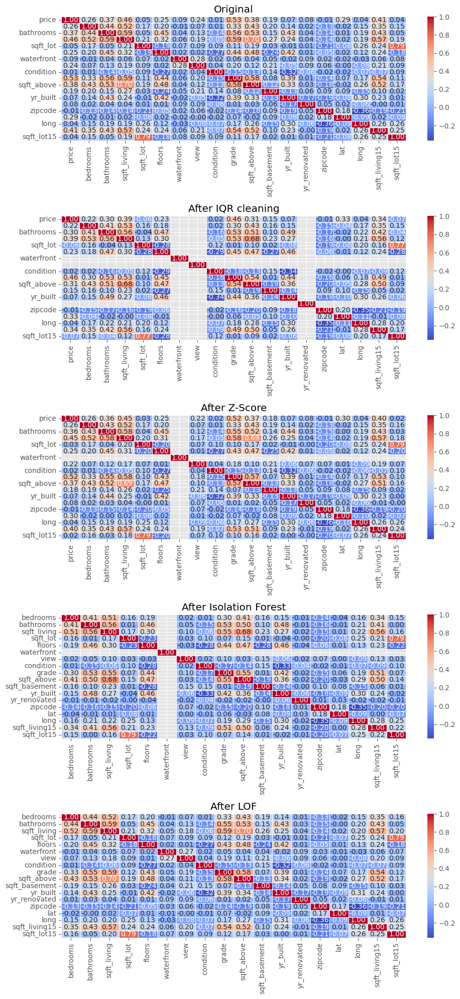

In [ ]:
## Análise de Correlações
# Esta seção explora as relações entre as variáveis

### Função para Múltiplos Heatmaps
def plot_multiple_heatmaps(datasets, titles, ignore_col=2, cols=1, figsize=(10, 20)):
    """Gera múltiplos heatmaps para comparação"""
    rows = (len(datasets) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=figsize)

    if rows == 1:
        axes = [axes]
    else:
        axes = axes.flatten()

    for i, (df, title) in enumerate(zip(datasets, titles)):
        data = df.iloc[:, ignore_col:]
        corr = data.corr(method='kendall')
        sns.heatmap(corr, ax=axes[i], annot=True, cmap="coolwarm", fmt=".2f", linewidths=.5)
        axes[i].set_title(title)

    for j in range(len(datasets), len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

### Aplicação da Função
# Criando lista de datasets e títulos para comparação
datasets = [original_df, clean_data_iqr, clean_data_z, clean_data_iso, clean_data_lof]
titles = ["Original", "After IQR cleaning", "After Z-Score", "After Isolation Forest", "After LOF"]

plot_multiple_heatmaps(datasets, titles)

# Exeperimentação com Modelos

### Funções de Suporte

In [6]:
# criação de funções de apoio para testes com diferentes modficações
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def print_model_evaluation(y_test, y_pred, feature_coefficients, name=None):
    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)

    # Print results
    if name:
        print(f"Model {name} Performance:")
    else:
        print(f"Model Performance:")

    print(f"MAE: {mae:,.2f}")
    print(f"MSE: {mse:,.2f}")
    print(f"RMSE: {rmse:,.2f}")
    print(f"R-squared: {r2:.4f}")
    print("\nFeature Coefficients:")
    print(feature_coefficients)

#Engenharia de atributos, modificação de colunas
def transform_df_modify_columns(df):
    transformed = df.copy()
    transformed = transformed.drop(columns=['yr_built', 'yr_renovated', 'sqft_basement', 'sqft_above'])
    transformed['house_age'] = 2015 - df['yr_built']
    transformed['living_to_lot_ratio'] = df['sqft_living'] / df['sqft_lot']
    transformed['bath_per_bed'] = df['bathrooms'] / df['bedrooms']
    #transformed['was_renovated'] = (df['yr_renovated'] > 0).astype(int)
    #transformed["price_per_sqft"] = df["price"] / df["sqft_living"]
    return transformed

#Transformação Polinomial das Coordenadas
def transform_df_polynomial(df):
    poly = PolynomialFeatures(degree=2, include_bias=False)
    df_poly = df.copy()
    poly_features = poly.fit_transform(df_poly[['lat', 'long']])
    df_poly[['lat', 'long', 'lat_sq', 'long_sq', 'lat_long']] = poly_features
    #df_poly = df_poly.drop(columns=['lat', 'long'])
    return df_poly

#Conversão em bins das coordenadas
def transform_df_spatial_binning(df):
    cut_df = df.copy()
    cut_df['lat_bin'] = pd.cut(cut_df['lat'], bins=5, labels=False)
    cut_df['long_bin'] = pd.cut(cut_df['long'], bins=5, labels=False)
    return cut_df

#Transformação logarítmica do Price
def transform_df_log_price(df):
    log_df = df.copy()
    log_df['price'] = np.log1p(log_df['price'])
    log_df["sqft_living"] = np.log1p(df["sqft_living"])
    log_df["sqft_lot"] = np.log1p(df["sqft_lot"])
    return log_df

#Impressão da avialiação na formatação correta após aplicação de Log
def print_transformed_evaluation(result):
    model = result['model']
    X_test = result['X_test']
    y_test = result['y_test']

    # Prever e reverter para dólares
    y_pred_log = model.predict(X_test)
    y_pred_dollar = np.expm1(y_pred_log)
    y_true_dollar = np.expm1(y_test)
    # Calcular Previsões Reais

    feature_coefficients = pd.DataFrame({
        'Feature': result['feature_names'],
        'Coefficient': model.coef_
    }).sort_values(by='Coefficient', ascending=False)
    print_model_evaluation(y_true_dollar, y_pred_dollar, feature_coefficients)

def complete_zipcodes_from_kc(df):
    file_id = "17zHf76n_Z_gXYu-kiRMb1upGRjz6JTpr"
    file_path = f"https://drive.google.com/uc?id={file_id}"
    df_zipcodes = pd.read_csv(file_path, header=None, names=['zipcode'])

    print(df_zipcodes)

    df_zipcodes['zipcode'] = df_zipcodes['zipcode'].astype(str).str.zfill(5)
    df_zipcodes['zipcode'] = 'zip_' + df_zipcodes['zipcode']

    for zip_col in df_zipcodes['zipcode'].unique():
      if zip_col not in df.columns:
          df[zip_col] = 0
    return df

#one-hot encoding do zipcode
def transform_zipcode_encoding(df):
    encoding_df = df.copy()
    encoding_df = pd.get_dummies(encoding_df, columns=['zipcode'], prefix='zip')
    encoding_df = complete_zipcodes_from_kc(encoding_df)
    return encoding_df

def transform_df_best_pipeline(df):
    new_df = df.copy()
    new_df = transform_df_polynomial(new_df)
    new_df = transform_zipcode_encoding(new_df)
    new_df = transform_df_modify_columns(new_df)

    #new_df = new_df.query('price <= 5000000 and bedrooms <= 9 and bathrooms <= 7')
    new_df = new_df.query('price >= 100000 and price <= 2000000 and bedrooms >= 1 and bedrooms <= 9 and bathrooms >= 1 and bathrooms <= 7')
    new_df = transform_df_log_price(new_df)
    new_df = new_df.drop(['sqft_living15','sqft_lot15'], axis=1)
    return new_df


## Linear Regression

### Criação do Modelo

In [7]:
#importação das bibliotecas
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

def train_linear_regression(df, test_size=0.2, random_state=42, drop_columns=[]):
    # Separation between features (X) and target variable (y)
    drop_columns.extend(['id', 'date', 'price'])
    X = df.drop(drop_columns, axis=1)
    y = df['price']

    # Split into training and test data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state
    )

    # Create and train the Linear Regression model
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)

    return {
        'model': lr_model,
        'X_test': X_test,
        'y_test': y_test,
        'X_train': X_train,
        'y_train': y_train,
        'feature_names': X.columns.tolist()
    }

def plot_graphs(y_test, y_pred):
    # Actual vs Predicted plot
    plt.figure(figsize=(10, 6))
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()],
            [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted Values')
    #plt.show()

    # Residual plot
    residuals = y_test - y_pred
    plt.figure(figsize=(10, 6))
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.axhline(y=0, color='r', linestyle='-')
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('Residual Analysis')
    #plt.show()


def evaluate_regression_model(results):
    model = results['model']
    X_test = results['X_test']
    y_test = results['y_test']

    # Make predictions
    y_pred = model.predict(X_test)

    # Feature coefficients
    coefficients = pd.DataFrame({
        'Feature': results['feature_names'],
        'Coefficient': model.coef_
    }).sort_values(by='Coefficient', ascending=False)

    print_model_evaluation( y_test, y_pred, coefficients)
    #plot_graphs(y_test, y_pred)

    return {
        'model': model,
        'X_test': X_test,
        'y_test': y_test,
        'X_train': results['X_train'],
        'y_train': results['y_train'],
        'feature_names': results['feature_names'],
        'feature_coefficients': coefficients
    }


def test_and_evaluate_model(df, test_size=0.2, random_state=42, drop_columns=[]):
    train_model = train_linear_regression(df, test_size, random_state, drop_columns)
    results = evaluate_regression_model(train_model)
    return results


### Teste e Avaliação do Modelo

#### Treinamento Com modelo Orignal

In [ ]:
# Previsões e métricas de avaliação
# Treinando modelo com dataset original

result = test_and_evaluate_model(original_df)

Model Performance:
MAE: 125,764.20
MSE: 39,721,763,277.34
RMSE: 199,303.19
R-squared: 0.6965

Feature Coefficients:
          Feature    Coefficient
14            lat  590649.796497
5      waterfront  569796.171683
8           grade   98258.820380
6            view   51906.954071
1       bathrooms   41725.689386
7       condition   29065.210587
4          floors    7878.122743
2     sqft_living     110.184489
9      sqft_above      68.442615
10  sqft_basement      41.741874
16  sqft_living15      26.019467
12   yr_renovated      20.161628
3        sqft_lot       0.114675
17     sqft_lot15      -0.469810
13        zipcode    -564.723176
11       yr_built   -2672.098989
0        bedrooms  -38189.033582
15           long -209535.725723


#### Treinamento Com Remoção do Zipcode

In [ ]:
# Treinando modelo com a remoção do zpicode, já que o mesmo é visto como
# inteiro. quando deveria ser uma variável categórica
# Modelo anterior [RMSE: 212,008.67 R-squared: 0.7005]

result = test_and_evaluate_model(original_df, drop_columns=['zipcode'])

Model Performance:
MAE: 126,334.60
MSE: 40,457,577,143.38
RMSE: 201,140.69
R-squared: 0.6909

Feature Coefficients:
          Feature    Coefficient
5      waterfront  573202.171853
13            lat  550820.668600
8           grade   99601.931731
6            view   48589.947243
1       bathrooms   42761.269926
7       condition   33427.775621
4          floors    1980.323264
2     sqft_living     108.371771
9      sqft_above      68.497717
10  sqft_basement      39.874054
15  sqft_living15      31.672789
12   yr_renovated      21.719130
3        sqft_lot       0.114802
16     sqft_lot15      -0.481025
11       yr_built   -2511.152717
0        bedrooms  -36624.456858
14           long -115231.449453


#### Remoção do Zipcode, Lat e Long

In [ ]:
# Treinando modelo com a remoção também do lat e long, teste para ver a
# influência dessas colunas no modelo. Visto que a remoção do zipcode piorou
# Modelo Original [RMSE: 212,008.67 R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81 R-squared: 0.6957]

result = test_and_evaluate_model(original_df, drop_columns=['zipcode','lat','long'])

Model Performance:
MAE: 141,020.70
MSE: 46,863,146,638.38
RMSE: 216,478.98
R-squared: 0.6419

Feature Coefficients:
          Feature    Coefficient
5      waterfront  561940.842012
8           grade  121190.471294
1       bathrooms   47761.073667
6            view   42375.202155
4          floors   27940.473802
7       condition   21552.581156
2     sqft_living     109.238409
10  sqft_basement      60.724702
9      sqft_above      48.513707
13  sqft_living15      30.192231
12   yr_renovated       9.874352
3        sqft_lot       0.002234
14     sqft_lot15      -0.656154
11       yr_built   -3615.673900
0        bedrooms  -42958.455076


#### Modificação e Transformação de Colunas

In [ ]:
# Treinando modelo com a modificação de algumas colunas
  # substituição do yr_built por house_age.
  # substituição do was_renovated por yr_renovated. (mudança de tipo)
  # criação do total_sqft em troca do sqft_living e sqft_basement. (soma)

# Visto que a remoção do zipcode, lat e long gerou uma piora nas previsões
# Modelo Original [RMSE: 212,008.67 R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81 R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44 R-squared: 0.6530]

new_variables_df = transform_df_modify_columns(original_df)
result = test_and_evaluate_model(new_variables_df)

Model Performance:
MAE: 68,003.46
MSE: 14,717,271,568.54
RMSE: 121,314.76
R-squared: 0.8876

Feature Coefficients:
           Feature    Coefficient
5       waterfront  237372.693259
8            grade   20050.562063
15   was_renovated   20039.142322
1        bathrooms   14743.213765
6             view   13659.728495
7        condition    6992.586232
16  price_per_sqft    2027.409445
2      sqft_living     290.021210
14       house_age     168.347180
3         sqft_lot      -0.134567
13      sqft_lot15      -0.222256
12   sqft_living15     -24.327342
9          zipcode    -138.014529
0         bedrooms   -1016.669563
11            long  -15083.202937
4           floors  -18296.355186
10             lat  -59526.641579


#### Transformação Polinomial das Coordenadas

In [ ]:
# Treinando modelo com a transformação da latitude e longitude em polinomial
# com o uso da biblioteca PolynomialFeatures do sklearn

# Visto que a modificação das colunas não gerou uma melhora significativa
# Modelo Original [RMSE: 212,008.67 R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81 R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44 R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03 R-squared: 0.6881]

df_with_poly = transform_df_polynomial(original_df)
result = test_and_evaluate_model(df_with_poly)

Model Performance:
MAE: 120,441.44
MSE: 36,629,387,505.79
RMSE: 191,388.05
R-squared: 0.7201

Feature Coefficients:
          Feature   Coefficient
15           long  1.866300e+08
5      waterfront  5.949569e+05
20       lat_long  3.626347e+05
8           grade  8.900578e+04
6            view  4.917342e+04
1       bathrooms  3.624638e+04
7       condition  2.869254e+04
14            lat  2.429112e+04
2     sqft_living  1.111623e+02
9      sqft_above  8.194821e+01
16  sqft_living15  2.945371e+01
10  sqft_basement  2.920989e+01
12   yr_renovated  2.386472e+01
3        sqft_lot  1.307362e-01
17     sqft_lot15 -2.577398e-01
13        zipcode -1.068981e+03
11       yr_built -2.030291e+03
4          floors -1.891216e+04
0        bedrooms -3.622844e+04
19        long_sq -2.069963e+06
18         lat_sq -2.654710e+06


#### Spatial Binning das Coordenadas

In [ ]:
# Treinando modelo com divisão da latitude e longitude por discretização espacial
# dividir a área geográfica em regiões menores

# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]

cut_coordinates_df = transform_df_spatial_binning(original_df)
result = test_and_evaluate_model(cut_coordinates_df)

Model Performance:
MAE: 125,194.65
MSE: 39,516,075,911.92
RMSE: 198,786.51
R-squared: 0.6981

Feature Coefficients:
          Feature    Coefficient
5      waterfront  571107.295713
14            lat  312017.879920
8           grade   98290.696822
6            view   50925.700000
1       bathrooms   40809.032966
18        lat_bin   35489.396729
7       condition   29119.999831
19       long_bin   27166.927759
4          floors    6763.219582
2     sqft_living     110.173008
9      sqft_above      68.607993
10  sqft_basement      41.565014
16  sqft_living15      26.521363
12   yr_renovated      20.413682
3        sqft_lot       0.115051
17     sqft_lot15      -0.466803
13        zipcode    -501.834979
11       yr_built   -2659.816175
0        bedrooms  -37372.247186
15           long -322124.787620


#### Transformação Logaritima do Price

In [ ]:
# Treinando modelo com transformação do da coluna price com logaritmo
# log1p é uma função da biblioteca numpy, sua utilização visa diminuir a
# assimetria dos preços e redução do impacto dos Outliers

# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]

log_price_df = transform_df_log_price(original_df)
result = test_and_evaluate_model(log_price_df)

print_transformed_evaluation(result)


Model Performance:
MAE: 0.20
MSE: 0.06
RMSE: 0.25
R-squared: 0.7621

Feature Coefficients:
          Feature   Coefficient
14            lat  1.390130e+00
5      waterfront  3.920048e-01
8           grade  1.605759e-01
4          floors  7.541501e-02
1       bathrooms  6.906462e-02
7       condition  6.447505e-02
6            view  5.711082e-02
16  sqft_living15  1.047788e-04
2     sqft_living  9.429011e-05
10  sqft_basement  5.436441e-05
9      sqft_above  3.992569e-05
12   yr_renovated  3.792886e-05
3        sqft_lot  4.334462e-07
17     sqft_lot15 -3.003137e-07
13        zipcode -6.385792e-04
11       yr_built -3.495923e-03
0        bedrooms -1.324980e-02
15           long -1.553744e-01
Model Performance:
MAE: 109,386.02
MSE: 30,406,344,200.29
RMSE: 174,374.15
R-squared: 0.7677

Feature Coefficients:
          Feature   Coefficient
14            lat  1.390130e+00
5      waterfront  3.920048e-01
8           grade  1.605759e-01
4          floors  7.541501e-02
1       bathrooms  6.9064

#### One-Hot encoding do Zipcode

In [ ]:
# Treinando modelo com transformação do da coluna zipcode com uso da
# técnica one-hot encoding já que o mesmo é visto como inteiro.
# quando deveria ser uma variável categórica

# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]

transform_zipcode_df = transform_zipcode_encoding(original_df)
result = test_and_evaluate_model(transform_zipcode_df)

Model Performance:
MAE: 97,168.43
MSE: 26,266,914,670.34
RMSE: 162,070.71
R-squared: 0.7993

Feature Coefficients:
       Feature   Coefficient
41   zip_98039  1.144689e+06
5   waterfront  6.407140e+05
20   zip_98004  5.310253e+05
65   zip_98112  4.173674e+05
42   zip_98040  3.114637e+05
..         ...           ...
19   zip_98003 -1.624626e+05
57   zip_98092 -1.665500e+05
85   zip_98198 -1.783121e+05
30   zip_98023 -1.886905e+05
52   zip_98070 -2.138357e+05

[87 rows x 2 columns]


#### Combinação de One-hot Encoding e Transformação Polinomial

In [ ]:
# Treinando modelo com combinação da modificação polinomial das coordenadas
# e one_hot encoding do zipcode. visto que o encoding teve o melhor resultado e
# a modificação polinomial teve o melhor resultado na manipulação das coordenadas

# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]

combine_poly_enc_df = transform_df_polynomial(original_df)
combine_poly_enc_df = transform_zipcode_encoding(combine_poly_enc_df)

result = test_and_evaluate_model(combine_poly_enc_df)

Model Performance:
MAE: 96,931.01
MSE: 26,313,508,359.14
RMSE: 162,214.39
R-squared: 0.7989

Feature Coefficients:
       Feature   Coefficient
13         lat  1.309430e+08
14        long  2.943638e+07
44   zip_98039  1.131268e+06
5   waterfront  6.417097e+05
23   zip_98004  5.160110e+05
..         ...           ...
86   zip_98178 -1.799806e+05
88   zip_98198 -1.801893e+05
18     long_sq -1.803263e+05
55   zip_98070 -2.261516e+05
17      lat_sq -1.606969e+06

[90 rows x 2 columns]


#### Combinação de Encoding, Polinomial e Modificação de Colunas

In [ ]:
# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]
# Modelo com encoding e polinomial [RMSE: 169,372.19, R-squared: 0.8089]

poly_enc_mod_df = transform_df_modify_columns(original_df)
poly_enc_mod_df = transform_df_polynomial(poly_enc_mod_df)
poly_enc_mod_df = transform_zipcode_encoding(poly_enc_mod_df)

result = test_and_evaluate_model(poly_enc_mod_df)

Model Performance:
MAE: 65,277.60
MSE: 13,904,901,729.77
RMSE: 117,919.05
R-squared: 0.8938

Feature Coefficients:
       Feature   Coefficient
10        long  3.106178e+07
43   zip_98039  5.823259e+05
5   waterfront  2.616188e+05
22   zip_98004  1.444378e+05
18    lat_long  9.972977e+04
..         ...           ...
54   zip_98070 -7.001778e+04
64   zip_98107 -7.364998e+04
70   zip_98117 -7.646639e+04
17     long_sq -1.406202e+05
9          lat -1.923912e+07

[89 rows x 2 columns]


#### Combinação Encoding, Polinomial e Logaritmo

In [ ]:
# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]
# Modelo com encoding e polinomial [RMSE: 169,372.19, R-squared: 0.8089]
# Modelo com enc, poly e mod colunas [RMSE: 177,853.15, R-squared: 0.7892]

new_model_df = transform_df_log_price(original_df)
new_model_df = transform_df_polynomial(new_model_df)
new_model_df = transform_zipcode_encoding(new_model_df)

result = test_and_evaluate_model(new_model_df)

print_transformed_evaluation(result)

Model Performance:
MAE: 0.14
MSE: 0.03
RMSE: 0.19
R-squared: 0.8743

Feature Coefficients:
       Feature  Coefficient
13         lat   261.738350
44   zip_98039     0.646656
23   zip_98004     0.545558
68   zip_98112     0.489655
5   waterfront     0.486323
..         ...          ...
19    lat_long    -0.381189
40   zip_98032    -0.403389
84   zip_98168    -0.406710
17      lat_sq    -2.476435
14        long  -103.329757

[90 rows x 2 columns]
Model Performance:
MAE: 74,774.16
MSE: 21,400,636,384.39
RMSE: 146,289.56
R-squared: 0.8365

Feature Coefficients:
       Feature  Coefficient
13         lat   261.738350
44   zip_98039     0.646656
23   zip_98004     0.545558
68   zip_98112     0.489655
5   waterfront     0.486323
..         ...          ...
19    lat_long    -0.381189
40   zip_98032    -0.403389
84   zip_98168    -0.406710
17      lat_sq    -2.476435
14        long  -103.329757

[90 rows x 2 columns]


#### Combinação Encoding, Polinomial e Remoção de outlier

In [ ]:
# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]
# Modelo com encoding e polinomial [RMSE: 169,372.19, R-squared: 0.8089]
# Modelo com enc, poly e mod colunas [RMSE: 177,853.15, R-squared: 0.7892]
# Modelo com enc, poly e log price [RMSE: 220,918.85, R-squared: 0.6748]

# Combinação de One-hot Encoding e Transformação Polinomial
combine_poly_enc_df = transform_df_polynomial(original_df)
combine_poly_enc_df = transform_zipcode_encoding(combine_poly_enc_df)

filtered_df = combine_poly_enc_df.copy()
filtered_df = filtered_df.query('price <= 5000000 and bedrooms <= 9 and bathrooms <= 7')

result = test_and_evaluate_model(filtered_df)

Model Performance:
MAE: 93,093.47
MSE: 22,090,812,697.78
RMSE: 148,629.78
R-squared: 0.8085

Feature Coefficients:
       Feature   Coefficient
13         lat  1.263232e+08
14        long  4.304883e+07
44   zip_98039  1.014666e+06
5   waterfront  6.325385e+05
23   zip_98004  5.562386e+05
..         ...           ...
86   zip_98178 -1.748217e+05
33   zip_98023 -1.762369e+05
88   zip_98198 -1.800279e+05
55   zip_98070 -2.468195e+05
17      lat_sq -1.398789e+06

[90 rows x 2 columns]


#### Combinação Encoding, Polinomial, Logaritimo e Remoção de outlier

In [ ]:
# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]
# Modelo com encoding e polinomial [RMSE: 169,372.19, R-squared: 0.8089]
# Modelo com enc, poly e mod colunas [RMSE: 177,853.15, R-squared: 0.7892]
# Modelo com enc, poly e log price [RMSE: 220,918.85, R-squared: 0.6748]
# Modelo com enc, poly e tratamento de outliers [RMSE: 151,283.12, R-squared: 0.8226]

# Combinação de One-hot Encoding e Transformação Polinomial
combine_poly_enc_df = transform_df_polynomial(original_df)
combine_poly_enc_df = transform_zipcode_encoding(combine_poly_enc_df)
filtered_df = combine_poly_enc_df.copy()

filtered_df = filtered_df.query('price <= 5000000 and bedrooms <= 9 and bathrooms <= 7')
filtered_df = transform_df_log_price(filtered_df)

result = test_and_evaluate_model(filtered_df)
print_transformed_evaluation(result)

Model Performance:
MAE: 0.13
MSE: 0.03
RMSE: 0.18
R-squared: 0.8814

Feature Coefficients:
       Feature  Coefficient
13         lat   296.504897
44   zip_98039     0.706296
23   zip_98004     0.569245
68   zip_98112     0.520494
5   waterfront     0.479215
..         ...          ...
87   zip_98188    -0.374185
40   zip_98032    -0.415653
84   zip_98168    -0.458453
17      lat_sq    -2.694155
14        long   -56.300084

[90 rows x 2 columns]
Model Performance:
MAE: 70,713.24
MSE: 13,732,372,766.92
RMSE: 117,185.21
R-squared: 0.8810

Feature Coefficients:
       Feature  Coefficient
13         lat   296.504897
44   zip_98039     0.706296
23   zip_98004     0.569245
68   zip_98112     0.520494
5   waterfront     0.479215
..         ...          ...
87   zip_98188    -0.374185
40   zip_98032    -0.415653
84   zip_98168    -0.458453
17      lat_sq    -2.694155
14        long   -56.300084

[90 rows x 2 columns]


#### Experimentação e Remoção de outlier

In [ ]:
# Modelo Original [RMSE: 212,008.67, R-squared: 0.7005]
# Modelo Sem Zipcode [RMSE: 213,724.81, R-squared: 0.6957]
# Modelo Sem Zipcode, Lat e Long [RMSE: 228,210.44, R-squared: 0.6530]
# Modelo com modificação de colunas [RMSE: 216,377.03, R-squared: 0.6881]
# Modelo com transformação polinomial [RMSE: 204,099.31, R-squared: 0.7225]
# Modelo com Spatial Binning [RMSE: 211,679.92, R-squared: 0.7015]
# Modelo com logaritmo do Price [RMSE: 273,734.13, R-squared: 0.5008]
# Modelo com one-hot encoding do zipcode [RMSE: 169,539.73, R-squared: 0.8085]
# Modelo com encoding e polinomial [RMSE: 169,372.19, R-squared: 0.8089]
# Modelo com enc, poly e mod colunas [RMSE: 177,853.15, R-squared: 0.7892]
# Modelo com enc, poly e log price [RMSE: 220,918.85, R-squared: 0.6748]
# Modelo com enc, poly e tratamento de outliers [RMSE: 151,283.12, R-squared: 0.8226]
# Modelo com enc, poly, outliers e log price [RMSE: 124,361.17, R-squared: 0.8659]

# Combinação de One-hot Encoding e Transformação Polinomial
filtered_df = transform_df_best_pipeline(original_df)
result = test_and_evaluate_model(filtered_df)#, drop_columns=['sqft_living15','sqft_lot15'])
print_transformed_evaluation(result)

numeric_describe = filtered_df.iloc[:,2:].describe().apply(lambda s: s.apply('{:,.0f}'.format))
print(numeric_describe)

Model Performance:
MAE: 0.05
MSE: 0.01
RMSE: 0.08
R-squared: 0.9767

Feature Coefficients:
        Feature  Coefficient
9           lat    30.959148
2   sqft_living     0.887062
72    zip_98136     0.071821
64    zip_98116     0.071802
49    zip_98070     0.070401
..          ...          ...
34    zip_98032    -0.100378
13     lat_long    -0.173977
12      long_sq    -0.179882
11       lat_sq    -0.553786
10         long   -33.915785

[87 rows x 2 columns]
Model Performance:
MAE: 26,451.39
MSE: 2,292,408,478.16
RMSE: 47,879.10
R-squared: 0.9716

Feature Coefficients:
        Feature  Coefficient
9           lat    30.959148
2   sqft_living     0.887062
72    zip_98136     0.071821
64    zip_98116     0.071802
49    zip_98070     0.070401
..          ...          ...
34    zip_98032    -0.100378
13     lat_long    -0.173977
12      long_sq    -0.179882
11       lat_sq    -0.553786
10         long   -33.915785

[87 rows x 2 columns]
        price bedrooms bathrooms sqft_living sqft_lot 

## Random Forest Regressor

### Criação do Modelo

In [ ]:
# Importação das bibliotecas
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

In [ ]:
# Função de treino
def train_random_forest(df, test_size=0.2, random_state=42, drop_columns=[]):
    drop_columns.extend(['id', 'date', 'price'])
    X = df.drop(drop_columns, axis=1)
    y = df['price']

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state
    )

    rf_model = RandomForestRegressor(n_estimators=100, random_state=random_state)
    rf_model.fit(X_train, y_train)

    return {
        'model': rf_model,
        'X_test': X_test,
        'y_test': y_test,
        'X_train': X_train,
        'y_train': y_train,
        'feature_names': X.columns.tolist()
    }

# Função de avaliação
def evaluate_random_forest_model(results):
    model = results['model']
    X_test = results['X_test']
    y_test = results['y_test']
    y_pred = model.predict(X_test)

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    erro_percentual = (rmse / y_test.mean()) * 100

    # Importância das features
    importances = pd.DataFrame({
        'Feature': results['feature_names'],
        'Importance': model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    # Impressão das métricas
    print("Random Forest Performance:")
    print(f"MSE: {mse:,.2f}")
    print(f"RMSE: {rmse:,.2f}")
    print(f"R-squared: {r2:.4f}")
    print(f"Erro percentual médio: {erro_percentual:.2f}%")
    print("\nTop 5 Important Features:")
    print(importances)

   # Gráfico: valores reais vs previstos
    print("\n")
    plt.figure(figsize=(10, 6))
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted Values')
    plt.grid(True)
    plt.show()

    # Gráfico de resíduos
    print("\n")
    residuals = y_test - y_pred
    plt.figure(figsize=(10, 6))
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.axhline(y=0, color='r', linestyle='-')
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('Residual Analysis')
    plt.grid(True)
    plt.show()
    print("\n")

    return {
        'RMSE': rmse,
        'MSE': mse,
        'R2': r2,
        'Erro percentual': erro_percentual
    }

In [ ]:
def test_and_evaluate_rf_model(df, test_size=0.2, random_state=42, drop_columns=[]):
    results = train_random_forest(df, test_size, random_state, drop_columns)
    return evaluate_random_forest_model(results)

### Teste e Avaliação do Modelo

In [ ]:
results_summary = []

#### Treinamento com Modelo Original

Random Forest Performance:
MSE: 15,390,590,570.37
RMSE: 124,058.82
R-squared: 0.8824
Erro percentual médio: 23.12%

Top 5 Important Features:
          Feature  Importance
2     sqft_living    0.293429
8           grade    0.293316
14            lat    0.158665
15           long    0.068819
5      waterfront    0.032935
16  sqft_living15    0.031897
11       yr_built    0.026729
9      sqft_above    0.021231
3        sqft_lot    0.014909
17     sqft_lot15    0.013729
13        zipcode    0.011966
6            view    0.009690
1       bathrooms    0.006389
10  sqft_basement    0.006050
7       condition    0.003312
0        bedrooms    0.003043
4          floors    0.002095
12   yr_renovated    0.001796




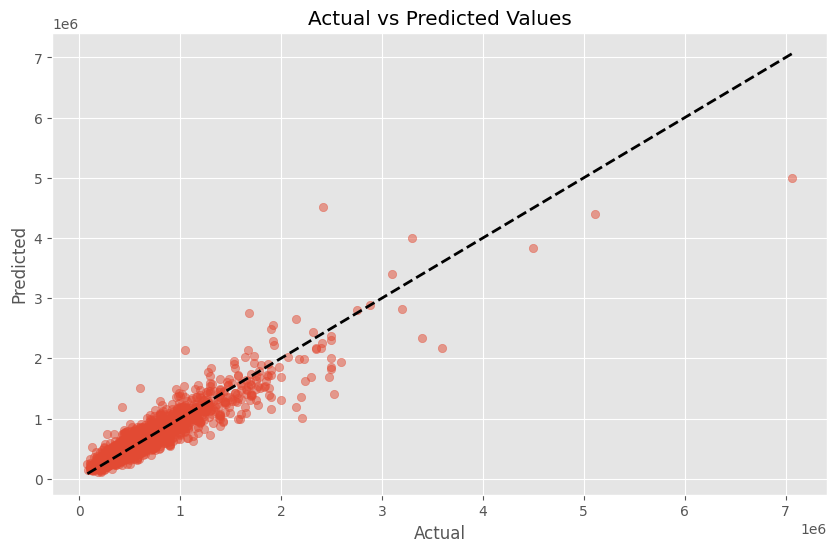

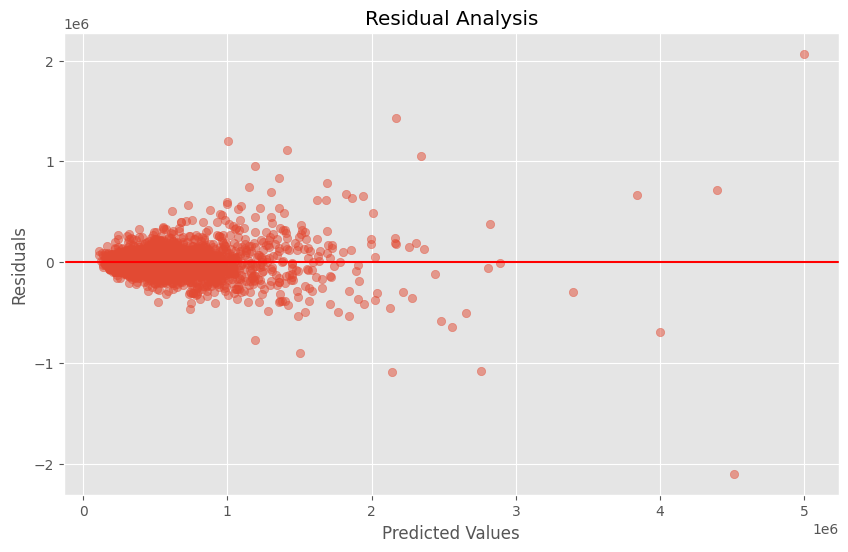

In [ ]:
res = test_and_evaluate_rf_model(original_df)
results_summary.append({'Versão': 'Original', **res})

#### Remoção do Zipcode

Random Forest Performance:
MSE: 15,783,122,116.98
RMSE: 125,630.90
R-squared: 0.8794
Erro percentual médio: 23.41%

Top 5 Important Features:
          Feature  Importance
8           grade    0.293620
2     sqft_living    0.293367
13            lat    0.161610
14           long    0.072414
15  sqft_living15    0.033090
5      waterfront    0.032784
11       yr_built    0.027232
9      sqft_above    0.021774
3        sqft_lot    0.016139
16     sqft_lot15    0.014419
6            view    0.009445
1       bathrooms    0.006835
10  sqft_basement    0.006149
0        bedrooms    0.003598
7       condition    0.003356
4          floors    0.002263
12   yr_renovated    0.001906




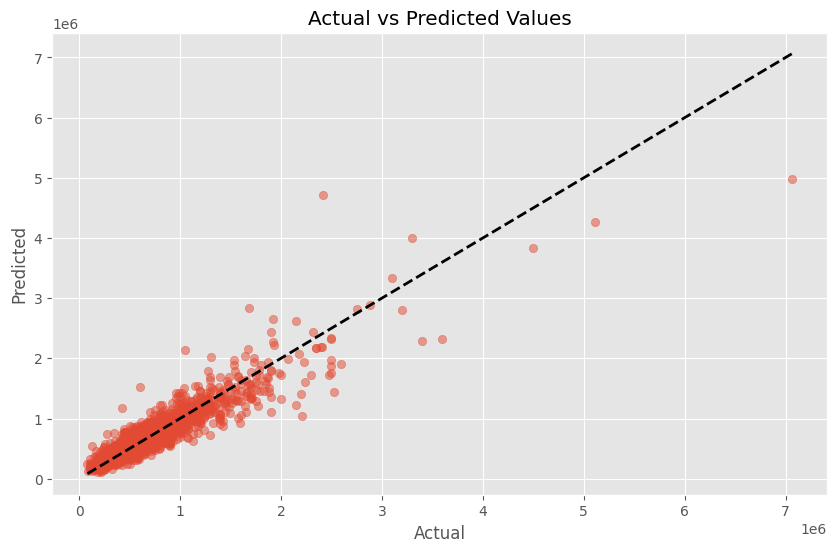

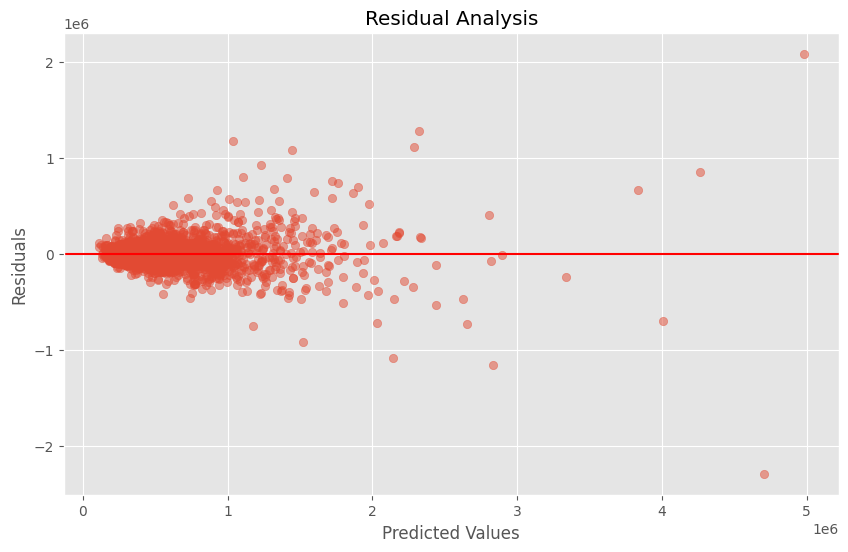

In [ ]:
res1 = test_and_evaluate_rf_model(original_df,  drop_columns=['zipcode'])
results_summary.append({'Versão': 'Sem zipcode', **res1})

#### Modificação e Transformação de Colunas

Random Forest Performance:
MSE: 16,532,995,591.20
RMSE: 128,580.70
R-squared: 0.8737
Erro percentual médio: 23.96%

Top 5 Important Features:
          Feature  Importance
7           grade    0.399561
14     total_sqft    0.189647
8             lat    0.157680
9            long    0.065692
10  sqft_living15    0.044747
12      house_age    0.035154
4      waterfront    0.030841
2        sqft_lot    0.019736
11     sqft_lot15    0.018516
1       bathrooms    0.016022
5            view    0.009089
0        bedrooms    0.004067
3          floors    0.004061
6       condition    0.003661
13  was_renovated    0.001523




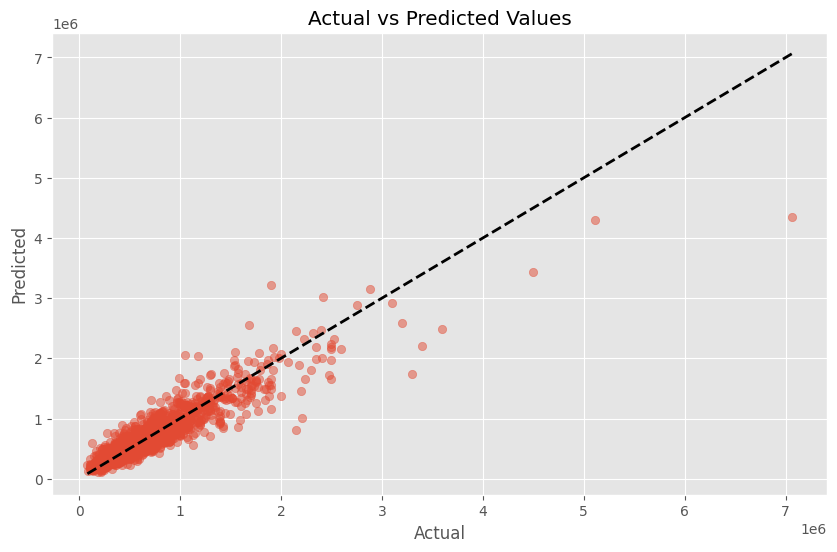

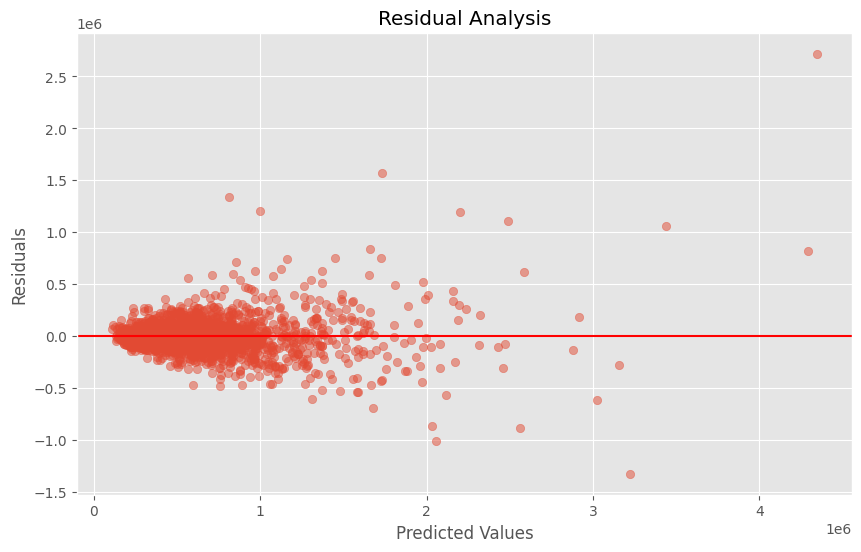

In [ ]:
new_variables_df = transform_df_modify_columns(original_df)

res2 =  test_and_evaluate_rf_model(new_variables_df, drop_columns=['zipcode'])
results_summary.append({'Versão': 'Variáveis novas + sem zipcode', **res2})

#### Transformação Polinomial das Coordenadas


Random Forest Performance:
MSE: 16,016,043,356.40
RMSE: 126,554.51
R-squared: 0.8776
Erro percentual médio: 23.59%

Top 5 Important Features:
          Feature  Importance
8           grade    0.292350
2     sqft_living    0.292259
13            lat    0.070768
17         lat_sq    0.061760
18        long_sq    0.045898
14           long    0.035577
19       lat_long    0.032697
15  sqft_living15    0.032520
5      waterfront    0.031528
11       yr_built    0.024565
9      sqft_above    0.020338
3        sqft_lot    0.014595
16     sqft_lot15    0.013270
6            view    0.009267
1       bathrooms    0.006666
10  sqft_basement    0.005715
7       condition    0.003322
0        bedrooms    0.002856
4          floors    0.002197
12   yr_renovated    0.001853




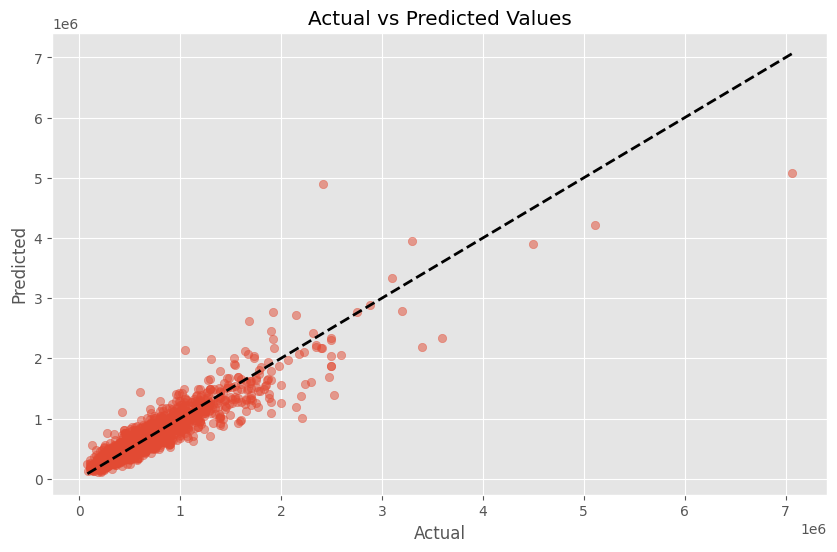

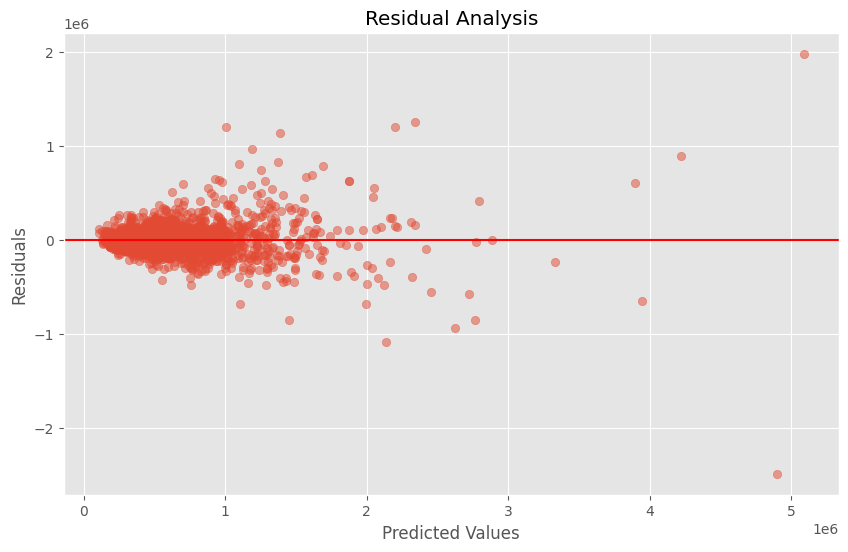

In [ ]:
df_with_poly = transform_df_polynomial(original_df)

res3 = test_and_evaluate_rf_model(df_with_poly, drop_columns=['zipcode'])
results_summary.append({'Versão': 'Polinômios em lat/long', **res3})

#### Bins para latitude e longitude

Random Forest Performance:
MSE: 15,245,393,002.23
RMSE: 123,472.24
R-squared: 0.8835
Erro percentual médio: 23.01%

Top 5 Important Features:
          Feature  Importance
2     sqft_living    0.293558
8           grade    0.293219
14            lat    0.156395
15           long    0.068969
5      waterfront    0.032977
16  sqft_living15    0.031530
11       yr_built    0.026730
9      sqft_above    0.021367
3        sqft_lot    0.014559
17     sqft_lot15    0.013921
13        zipcode    0.012125
6            view    0.009513
1       bathrooms    0.006147
10  sqft_basement    0.005830
7       condition    0.003327
0        bedrooms    0.003102
18        lat_bin    0.002400
4          floors    0.001987
12   yr_renovated    0.001768
19       long_bin    0.000577




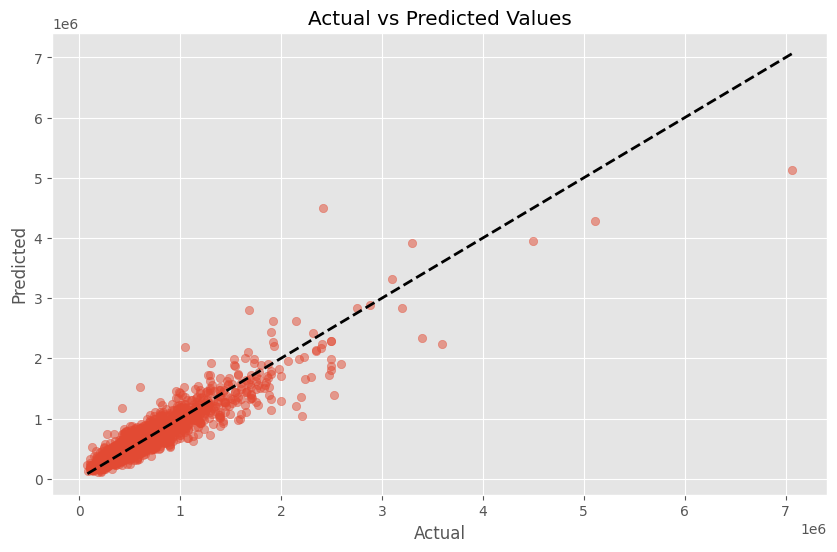

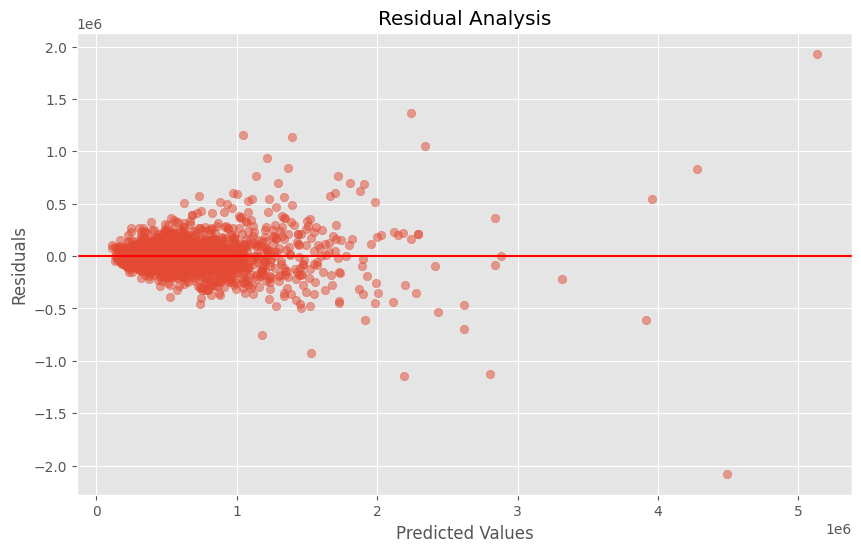

In [ ]:
new_df = transform_df_spatial_binning(original_df)
res4 = test_and_evaluate_rf_model(new_df)
results_summary.append({'Versão': 'Com bins lat/long', **res4})

#### Transformação Logaritima do Price

Random Forest Performance:
MSE: 0.03
RMSE: 0.17
R-squared: 0.8888
Erro percentual médio: 1.34%

Top 5 Important Features:
          Feature  Importance
8           grade    0.338629
14            lat    0.290337
2     sqft_living    0.186423
15           long    0.046898
16  sqft_living15    0.026813
11       yr_built    0.020816
3        sqft_lot    0.016039
17     sqft_lot15    0.014787
9      sqft_above    0.014298
13        zipcode    0.010237
6            view    0.008566
5      waterfront    0.007380
1       bathrooms    0.005094
7       condition    0.004649
10  sqft_basement    0.003308
0        bedrooms    0.002885
4          floors    0.001463
12   yr_renovated    0.001380




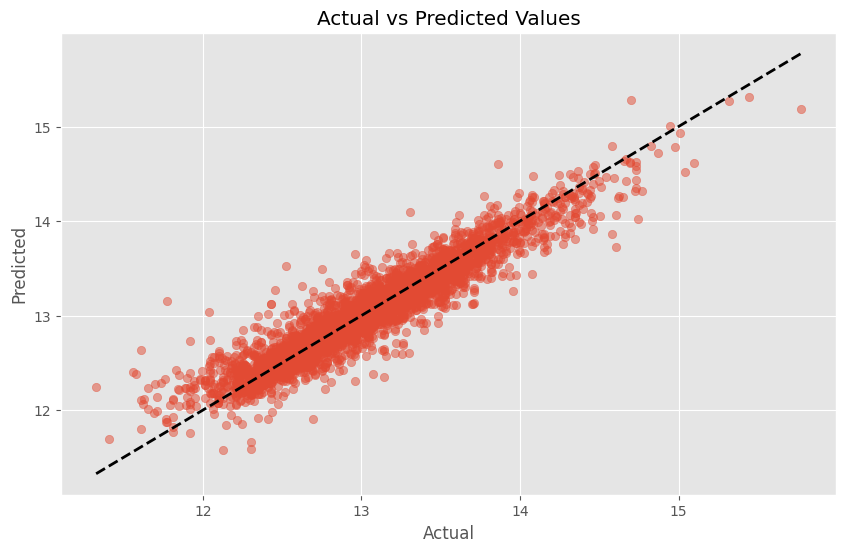

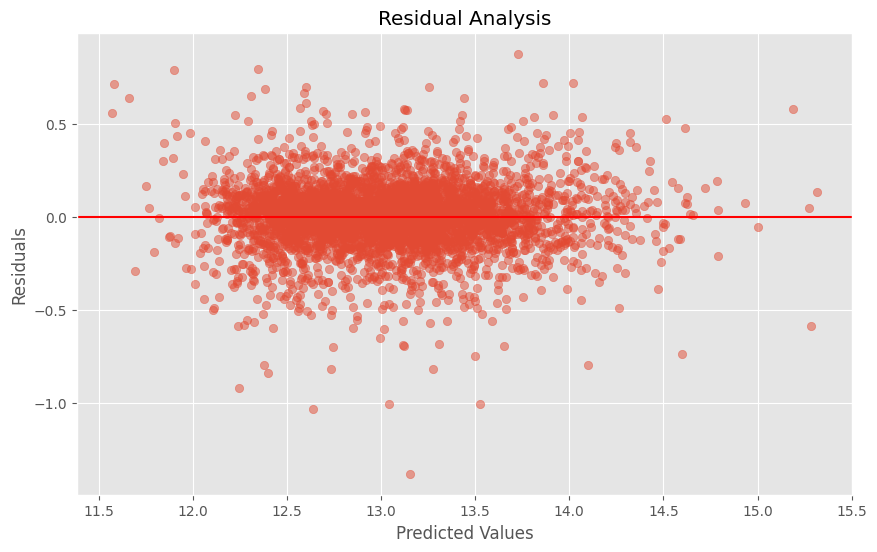

In [ ]:
log_price_df = transform_df_log_price(original_df)

res5 = test_and_evaluate_rf_model(log_price_df)
results_summary.append({'Versão': 'Log(price)', **res5})

#### Combinação de One-hot Encoding e Transformação Polinomial

Random Forest Performance:
MSE: 15,625,469,622.30
RMSE: 125,001.88
R-squared: 0.8806
Erro percentual médio: 23.30%

Top 5 Important Features:
        Feature  Importance
8         grade    0.292209
2   sqft_living    0.291926
17       lat_sq    0.066939
13          lat    0.061367
18      long_sq    0.045643
..          ...         ...
87    zip_98188    0.000010
38    zip_98030    0.000009
81    zip_98148    0.000006
32    zip_98022    0.000004
21    zip_98002    0.000004

[90 rows x 2 columns]




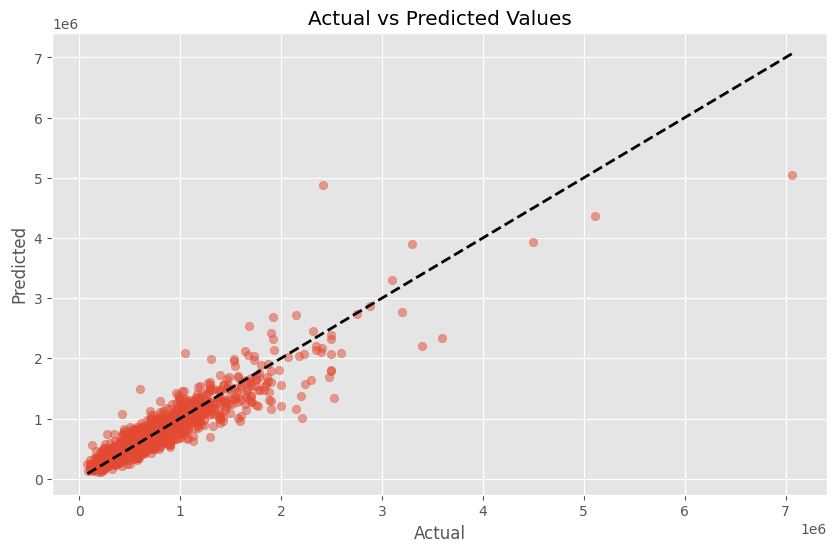

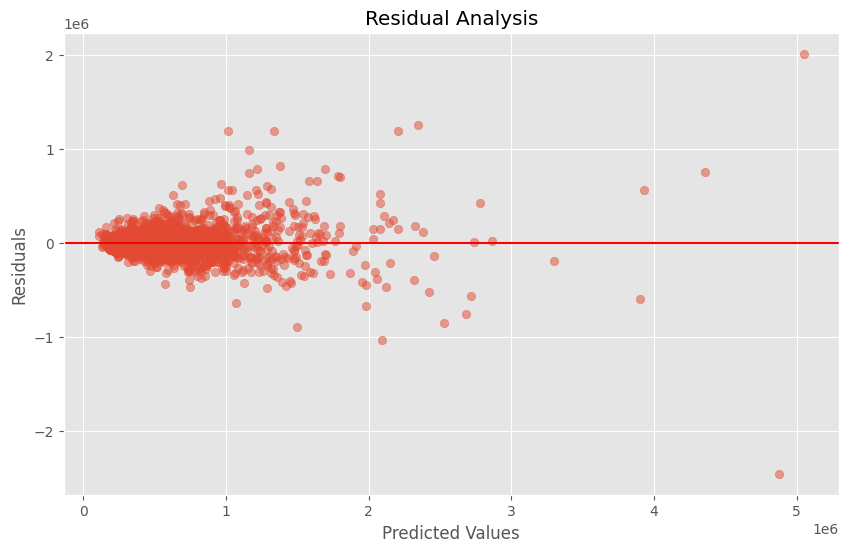

{'RMSE': np.float64(125001.87847507096),
 'MSE': 15625469622.296408,
 'R2': 0.8806119204857794,
 'Erro percentual': np.float64(23.29645811285582)}

In [ ]:
combine_poly_enc_df = transform_df_polynomial(original_df)
combine_poly_enc_df = transform_zipcode_encoding(combine_poly_enc_df)

rf_results = train_random_forest(combine_poly_enc_df)
evaluate_random_forest_model(rf_results)

#### Combinação Encoding, Polinomial e Remoção de outlier


Random Forest Performance:
MSE: 13,858,209,796.42
RMSE: 117,720.90
R-squared: 0.8799
Erro percentual médio: 22.16%

Top 5 Important Features:
        Feature  Importance
8         grade    0.330410
2   sqft_living    0.228693
17       lat_sq    0.068811
13          lat    0.065455
18      long_sq    0.052351
..          ...         ...
38    zip_98030    0.000008
39    zip_98031    0.000007
40    zip_98032    0.000007
21    zip_98002    0.000004
32    zip_98022    0.000004

[90 rows x 2 columns]




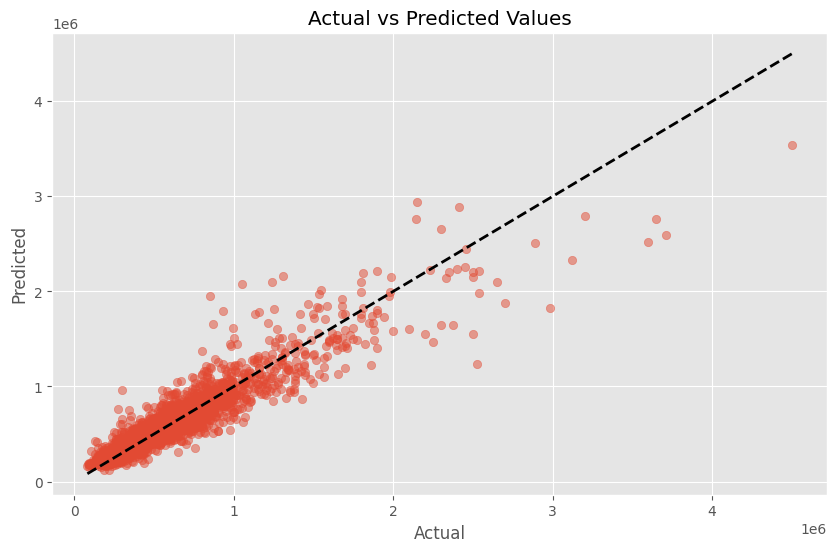

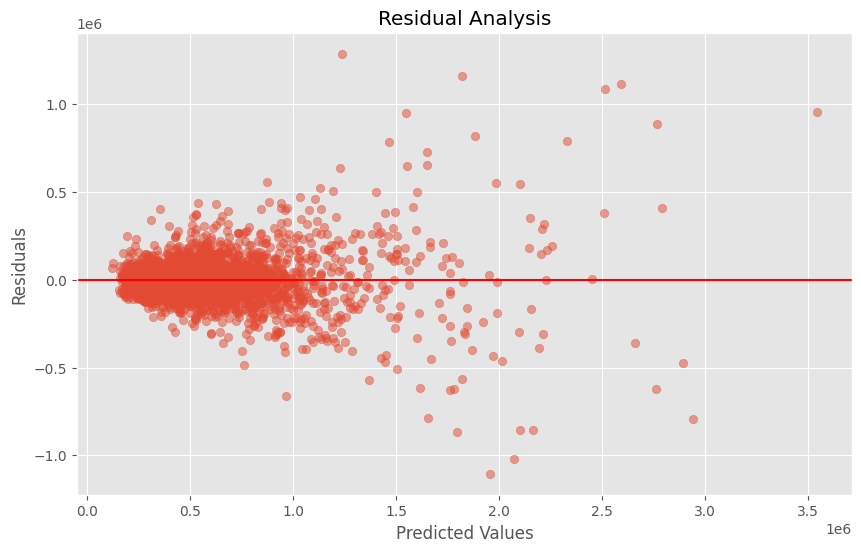

{'RMSE': np.float64(117720.89787468476),
 'MSE': 13858209796.421959,
 'R2': 0.879864789832519,
 'Erro percentual': np.float64(22.15924943981606)}

In [ ]:
combine_poly_enc_df = transform_df_polynomial(original_df)
combine_poly_enc_df = transform_zipcode_encoding(combine_poly_enc_df)

filtered_df = combine_poly_enc_df.copy()
filtered_df = filtered_df.query('price <= 5000000 and bedrooms <= 9 and bathrooms <= 7')

rf_results = train_random_forest(filtered_df)
evaluate_random_forest_model(rf_results)

### Comparação entre Versões do Modelo Random Forest



In [ ]:
df_results = pd.DataFrame(results_summary)
print("\n")
formatted_results = df_results.copy()

# Aplicar formatação nas colunas numéricas
formatted_results['RMSE'] = formatted_results['RMSE'].apply(lambda x: f"{x:,.6f}")
formatted_results['MSE'] = formatted_results['MSE'].apply(lambda x: f"{x:,.8f}")
formatted_results['R2'] = formatted_results['R2'].apply(lambda x: f"{x:.4f}")
formatted_results['Erro percentual'] = formatted_results['Erro percentual'].apply(lambda x: f"{x:.2f}%")

# Exibir a tabela formatada
formatted_results

,Versão,RMSE,MSE,R2,Erro percentual
0,Original,"124,058.818995","15,390,590,570.36918831",0.8824,23.12%
1,Sem zipcode,"125,630.896347","15,783,122,116.98328209",0.8794,23.41%
2,Variáveis novas + sem zipcode,"128,580.696806","16,532,995,591.20264816",0.8737,23.96%
3,Polinômios em lat/long,"126,554.507452","16,016,043,356.39962387",0.8776,23.59%
4,Com bins lat/long,"123,472.235755","15,245,393,002.22547531",0.8835,23.01%
5,Log(price),0.174183,0.03033979,0.8888,1.34%


## Teste de Múltiplos Modelos


Teste em diferentes modelos  do melhor Pré-Processamento dos dados, obtido por experimentações com o Linear Regression. Exibição de tabela para comparação da performance de cada modelo

- Linear Regression
- Random Forest
- Gradient Boosting
- XGBoost
- LightGBM

In [10]:
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split

def calculate_model_evaluation(y_test, y_pred, model_name):
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    erro_percentual = (rmse / y_test.mean()) * 100

    return {
        'Model': model_name,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2,
        'Erro percentual': erro_percentual
    }

def test_multiple_models(df, test_size=0.2, random_state=42, n_estimators=100, drop_columns=[]):
    drop_columns.extend(['id', 'date', 'price'])

    X = df.drop(drop_columns, axis=1)
    y = df['price']

    scaler = StandardScaler()
    #X_scaled = scaler.fit_transform(X)

    #kmeans = KMeans(n_clusters=50, random_state=42)
    #clusters = kmeans.fit_predict(X_scaled)

    #df['cluster'] = clusters

    #X = df.drop(drop_columns, axis=1)
    X_scaled = scaler.fit_transform(X)


    # Split into training and test data
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y, test_size=test_size, random_state=random_state
    )

    modelos = {
      'GradientBoosting': GradientBoostingRegressor(n_estimators=n_estimators, random_state=random_state),
      'XGBoost': XGBRegressor(n_estimators=n_estimators, random_state=random_state, verbosity=0),
      'LightGBM': LGBMRegressor(n_estimators=n_estimators, random_state=random_state),
      'RandomForest': RandomForestRegressor(n_estimators=n_estimators, random_state=random_state),
      'LinearRegression': LinearRegression()
    }

    resultados = []
    for nome, modelo in modelos.items():
        modelo.fit(X_train, y_train)
        y_pred = modelo.predict(X_test)
        resultados.append(calculate_model_evaluation(np.expm1(y_test), np.expm1(y_pred), nome))

    df_results = pd.DataFrame(resultados)
    print("\n")
    formatted_results = df_results.copy()

    # Aplicar formatação nas colunas numéricas
    formatted_results['MAE'] = formatted_results['MAE'].apply(lambda x: f"{x:,.2f}")
    formatted_results['MSE'] = formatted_results['MSE'].apply(lambda x: f"{x:,.2f}")
    formatted_results['RMSE'] = formatted_results['RMSE'].apply(lambda x: f"{x:,.2f}")
    formatted_results['R2'] = formatted_results['R2'].apply(lambda x: f"{x:.4f}")
    formatted_results['Erro percentual'] = formatted_results['Erro percentual'].apply(lambda x: f"{x:.2f}%")

    # Exibir a tabela formatada
    return print(formatted_results)


In [ ]:
from datetime import datetime
filtered_df = transform_df_best_pipeline(original_df)
print(f"Original shape: {filtered_df.shape}")
test_multiple_models(filtered_df)

print("")
print(f"After IQR cleaning: {clean_data_iqr.shape}")
filtered_df = transform_df_best_pipeline(clean_data_iqr)
test_multiple_models(filtered_df)

print("")
print(f"After Z-Score: {clean_data_z.shape}")
filtered_df = transform_df_best_pipeline(clean_data_z)
test_multiple_models(filtered_df)
print("")
print(f"After Isolation Forest: {clean_data_iso.shape}")
clean_data_iso["date"] = datetime.now
filtered_df = transform_df_best_pipeline(clean_data_iso)
test_multiple_models(filtered_df)
print("")
print(f"After LOF: {clean_data_lof.shape}")
filtered_df = transform_df_best_pipeline(clean_data_lof)
test_multiple_models(filtered_df)

Original shape: (21393, 90)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008507 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2490
[LightGBM] [Info] Number of data points in the train set: 17114, number of used features: 87
[LightGBM] [Info] Start training from score 13.029876


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(




              Model        MAE                MSE        RMSE      R2  \
0  GradientBoosting  69,503.78  11,746,559,209.94  108,381.54  0.8546   
1           XGBoost  62,162.07   9,492,415,056.59   97,429.03  0.8825   
2          LightGBM  61,295.56   9,266,300,152.63   96,261.62  0.8853   
3      RandomForest  63,827.14  10,527,571,859.36  102,603.96  0.8696   
4  LinearRegression  70,143.86  11,692,885,583.80  108,133.65  0.8552   

  Erro percentual  
0          20.75%  
1          18.65%  
2          18.43%  
3          19.64%  
4          20.70%  

After IQR cleaning: (16682, 22)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005944 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2496
[LightGBM] [Info] Number of data points in the train set: 13345, number of used features: 83
[LightGBM] [Info] Start training from score 12.937321


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(




              Model        MAE               MSE       RMSE      R2  \
0  GradientBoosting  55,386.85  6,967,046,702.86  83,468.84  0.8475   
1           XGBoost  50,368.05  5,803,927,617.37  76,183.51  0.8730   
2          LightGBM  49,572.34  5,776,271,222.29  76,001.78  0.8736   
3      RandomForest  51,353.47  6,228,549,064.40  78,921.16  0.8637   
4  LinearRegression  55,764.64  6,974,463,447.04  83,513.25  0.8474   

  Erro percentual  
0          18.24%  
1          16.65%  
2          16.61%  
3          17.25%  
4          18.25%  

After Z-Score: (20978, 21)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007864 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2479
[LightGBM] [Info] Number of data points in the train set: 16736, number of used features: 86
[LightGBM] [Info] Start training from score 13.023897


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(




              Model        MAE                MSE        RMSE      R2  \
0  GradientBoosting  67,006.90  10,611,864,174.95  103,013.90  0.8630   
1           XGBoost  59,024.53   8,444,806,947.29   91,895.63  0.8910   
2          LightGBM  58,401.69   8,096,425,081.70   89,980.14  0.8955   
3      RandomForest  62,388.90   9,325,570,784.21   96,568.99  0.8796   
4  LinearRegression  67,931.65  10,485,371,706.55  102,398.10  0.8646   

  Erro percentual  
0          20.11%  
1          17.94%  
2          17.56%  
3          18.85%  
4          19.99%  

After Isolation Forest: (19436, 20)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2471
[LightGBM] [Info] Number of data points in the train set: 15540, number of used features: 85
[LightGBM] [Info] Start training from score 12.980134


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(




              Model        MAE               MSE       RMSE      R2  \
0  GradientBoosting  60,651.44  8,281,588,471.11  91,003.23  0.8393   
1           XGBoost  53,119.13  6,595,289,718.47  81,211.39  0.8720   
2          LightGBM  52,479.79  6,500,372,401.01  80,624.89  0.8739   
3      RandomForest  55,502.37  7,230,407,339.96  85,031.80  0.8597   
4  LinearRegression  60,245.98  7,987,195,500.10  89,371.11  0.8450   

  Erro percentual  
0          18.80%  
1          16.78%  
2          16.66%  
3          17.57%  
4          18.47%  

After LOF: (19436, 20)


KeyError: "['date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date', 'date'] not found in axis"

## KMeans E DBSCAN

### Criação do Modelo

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors

# Pré-processamento
# Selecionar features relevantes para clustering
features = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'lat', 'long']
X = original_df[features]

# Tratar valores ausentes (se houver)
X = X.dropna()

# Normalização dos dados
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

### Avaliação do Modelo


# Create Model File

In [14]:
def predict_model(payload, model):
    if type(payload) == dict:
        df = pd.DataFrame(payload)
    else:
        df = payload
    y_pred = model.predict(df)
    return y_pred


import pickle
import os
script_dir = os.getcwd()

def serialize_model(model, model_name):
    filename = f"serializers/models-{model_name}.pkl"
    file_path = os.path.join(script_dir, filename)

    with open(file_path, 'wb') as file:
        pickle.dump(model, file)
    print(f"Model serialized and saved as {filename}")


def deserialize_model(model_name):
    filename = f"serializers/models-{model_name}.pkl"
    file_path = os.path.join(script_dir, filename)

    with open(file_path, 'rb') as file:
        return pickle.load(file)

In [15]:
def serialize_multiple_models(df, test_size=0.2, random_state=42, n_estimators=100, drop_columns=[]):
    drop_columns.extend(['id', 'date', 'price'])
    X = df.drop(drop_columns, axis=1)
    y = df['price']

    # Split into training and test data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state
    )

    modelos = {
      'GradientBoosting': GradientBoostingRegressor(n_estimators=n_estimators, random_state=random_state),
      'XGBoost': XGBRegressor(n_estimators=n_estimators, random_state=random_state, verbosity=0),
      'LightGBM': LGBMRegressor(n_estimators=n_estimators, random_state=random_state),
      'RandomForest': RandomForestRegressor(n_estimators=n_estimators, random_state=random_state),
      'LinearRegression': LinearRegression()
    }

    for nome, modelo in modelos.items():
        modelo.fit(X_train, y_train)
        y_pred = modelo.predict(X_test)
        print(nome)
        serialize_model(modelo, nome)



In [16]:
temp_df = transform_df_best_pipeline(original_df)
temp_df = temp_df[sorted(temp_df.columns)]
serialize_multiple_models(temp_df)

    zipcode
0     98001
1     98002
2     98003
3     98004
4     98005
..      ...
82    98199
83    98224
84    98288
85    98354
86    98422

[87 rows x 1 columns]
GradientBoosting
Model serialized and saved as serializers/models-GradientBoosting.pkl
XGBoost
Model serialized and saved as serializers/models-XGBoost.pkl
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002307 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2413
[LightGBM] [Info] Number of data points in the train set: 17036, number of used features: 87
[LightGBM] [Info] Start training from score 13.036628
LightGBM
Model serialized and saved as serializers/models-LightGBM.pkl
RandomForest
Model serialized and saved as serializers/models-RandomForest.pkl
LinearRegression
Model serialized and saved as serializers/models-LinearRegression.pkl
